# 互评作业1: 数据探索性分析与数据预处理
# 1120191287 林超超
## 1. 问题描述
本次作业中，自行选择2个数据集进行探索性分析与预处理。

## 2. 数据集
可选数据集包括：

Alzheimer Disease and Healthy Aging Data in US

Movies Dataset from Pirated Sites

## 3. 数据分析要求
### 3.1 数据摘要和可视化
• 数据摘要

标称属性，给出每个可能取值的频数

数值属性，给出5数概括及缺失值的个数

• 数据可视化

使用直方图、盒图等检查数据分布及离群点

### 3.2 数据缺失的处理
观察数据集中缺失数据，分析其缺失的原因。分别使用下列四种策略对缺失值进行处理:

• 将缺失部分剔除

• 用最高频率值来填补缺失值

• 通过属性的相关关系来填补缺失值

• 通过数据对象之间的相似性来填补缺失值

注意：在处理后完成，要对比新旧数据集的差异。

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder
from sklearn.ensemble import RandomForestRegressor
import numpy as np
from impyute.imputation.cs import fast_knn
import sys

## 数据集1-Alzheimer Disease and Healthy Aging Data In US
"Exploring Alzheimer's Disease and Aging Trends in US: A Comprehensive Dataset"

In [2]:
# # 加载Alzheimer Disease and Healthy Aging Data In US
df1 = pd.read_csv("./Alzheimer Disease and Healthy Aging Data In US.csv")
df1

C:\Users\RO\AppData\Local\Temp/ipykernel_10144/595115884.py:2: DtypeWarning: Columns (13,14) have mixed types. Specify dtype option on import or set low_memory=False.
  df1 = pd.read_csv("./Alzheimer Disease and Healthy Aging Data In US.csv")


,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,DataValueTypeID,...,Stratification2,Geolocation,ClassID,TopicID,QuestionID,LocationID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2
0,2020,2020,HI,Hawaii,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,NaN,POINT (-157.8577494 21.30485044),C01,TOC11,Q43,15,AGE,5064,OVERALL,OVERALL
1,2017,2017,ID,Idaho,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,NaN,POINT (-114.36373 43.68263001),C05,TMC03,Q27,16,AGE,5064,OVERALL,OVERALL
2,2017,2017,ID,Idaho,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,NaN,POINT (-114.36373 43.68263001),C01,TOC11,Q43,16,AGE,5064,OVERALL,OVERALL
3,2018,2018,ID,Idaho,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,NaN,POINT (-114.36373 43.68263001),C01,TOC01,Q08,16,AGE,5064,OVERALL,OVERALL
4,2020,2020,IN,Indiana,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-86.14996019 39.76691045),C05,TMC03,Q27,18,AGE,AGE_OVERALL,GENDER,MALE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214457,2016,2016,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"Black, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56,AGE,5064,RACE,BLK
214458,2015,2015,WY,Wyoming,BRFSS,Smoking and Alcohol Use,Current smoking,Percentage of older adults who have smoked at ...,%,PRCTG,...,Asian/Pacific Islander,POINT (-108.1098304 43.23554134),C04,TAC01,Q17,56,AGE,65PLUS,RACE,ASN
214459,2017,2017,WY,Wyoming,BRFSS,Overall Health,Self-rated health (fair to poor health),Percentage of older adults who self-reported t...,%,PRCTG,...,Native Am/Alaskan Native,POINT (-108.1098304 43.23554134),C01,TOC07,Q32,56,AGE,AGE_OVERALL,RACE,NAA
214460,2016,2016,WY,Wyoming,BRFSS,Overall Health,Fall with injury within last year,Percentage of older adults who have fallen and...,%,PRCTG,...,NaN,POINT (-108.1098304 43.23554134),C01,TOC06,Q05,56,AGE,5064,OVERALL,OVERALL


In [3]:
# 数据集各列属性
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214462 entries, 0 to 214461
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   YearStart                  214462 non-null  int64  
 1   YearEnd                    214462 non-null  int64  
 2   LocationAbbr               214462 non-null  object 
 3   LocationDesc               214462 non-null  object 
 4   Datasource                 214462 non-null  object 
 5   Class                      214462 non-null  object 
 6   Topic                      214462 non-null  object 
 7   Question                   214462 non-null  object 
 8   Data_Value_Unit            214462 non-null  object 
 9   DataValueTypeID            214462 non-null  object 
 10  Data_Value_Type            214462 non-null  object 
 11  Data_Value                 144629 non-null  float64
 12  Data_Value_Alt             144629 non-null  float64
 13  Low_Confidence_Limit       14

In [4]:
# 处理类型错误的列
df1['Low_Confidence_Limit'] = df1['Low_Confidence_Limit'].astype(str)
df1['High_Confidence_Limit'] = df1['High_Confidence_Limit'].astype(str)

### 1. 数据摘要和可视化
#### 1.1 数据摘要

In [5]:
# 标称属性，给出每个可能取值的频数
frequency = {key: df1[key].value_counts() for key in df1.columns}
frequency

{'YearStart': 2015    45980
 2020    36006
 2019    34354
 2016    34145
 2017    33429
 2018    30548
 Name: YearStart, dtype: int64,
 'YearEnd': 2020    46966
 2015    35020
 2019    34354
 2016    34145
 2017    33429
 2018    30548
 Name: YearEnd, dtype: int64,
 'LocationAbbr': US      4644
 WEST    4638
 NRE     4614
 MDW     4611
 OR      4565
 NY      4557
 SOU     4542
 UT      4222
 OH      3955
 GA      3951
 MD      3919
 HI      3907
 TN      3879
 MI      3796
 VA      3758
 FL      3753
 ME      3733
 TX      3699
 NV      3696
 DC      3684
 WV      3682
 MS      3677
 PA      3648
 NM      3635
 AL      3633
 KY      3623
 AK      3611
 SC      3592
 NJ      3589
 AZ      3582
 MO      3573
 IL      3571
 IN      3570
 WI      3569
 LA      3563
 MN      3555
 NE      3546
 CT      3543
 RI      3534
 OK      3526
 SD      3526
 ND      3514
 KS      3510
 ID      3507
 IA      3501
 AR      3498
 WY      3494
 CA      3447
 CO      3390
 NC      3349
 WA      3348
 MT 

In [6]:
# 数值属性，给出5数概括及缺失值的个数
# YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
describe1 = df1.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
min,2015.0,2015.0,0.0,0.0,NaN,1.0
25%,2016.0,2016.0,15.3,15.3,NaN,18.0
50%,2017.0,2018.0,32.5,32.5,NaN,33.0
75%,2019.0,2019.0,56.8,56.8,NaN,49.0
max,2020.0,2020.0,100.0,100.0,NaN,9004.0
NaN count,0.0,0.0,69833.0,69833.0,214462.0,0.0


#### 1.2 数据可视化

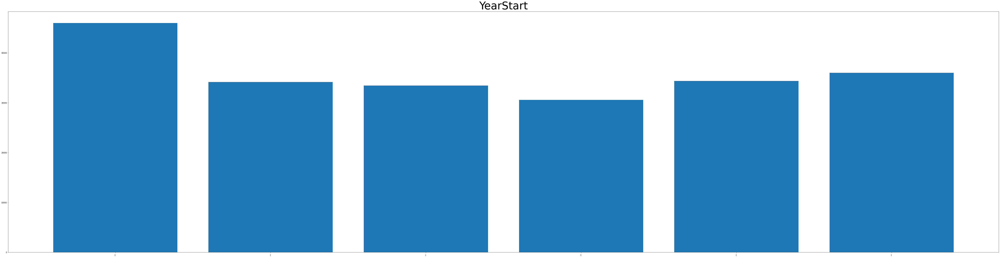

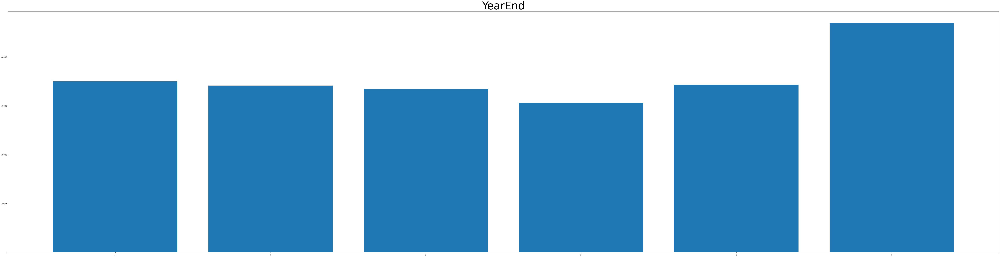

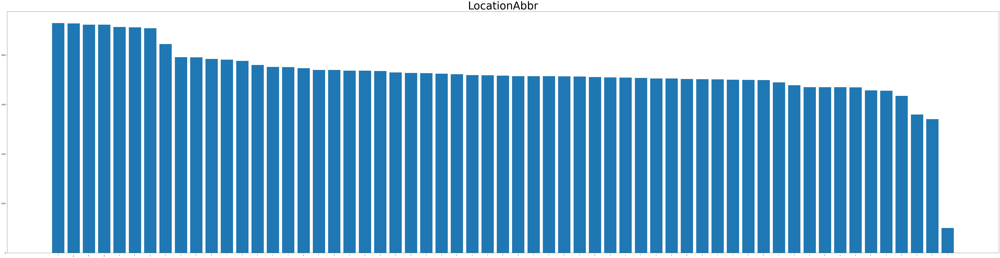

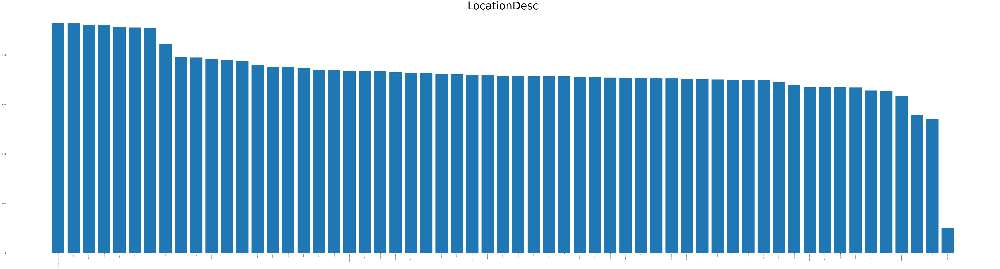

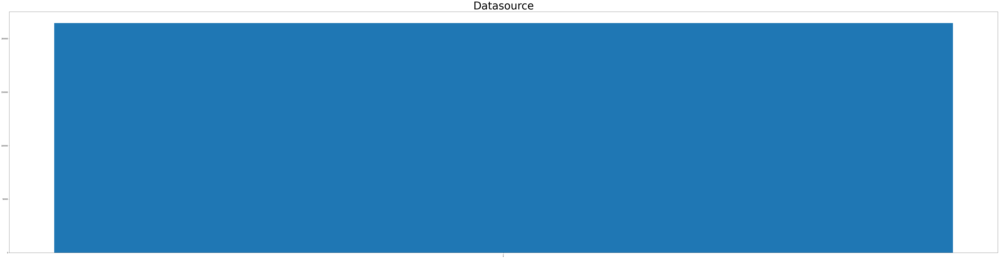

...

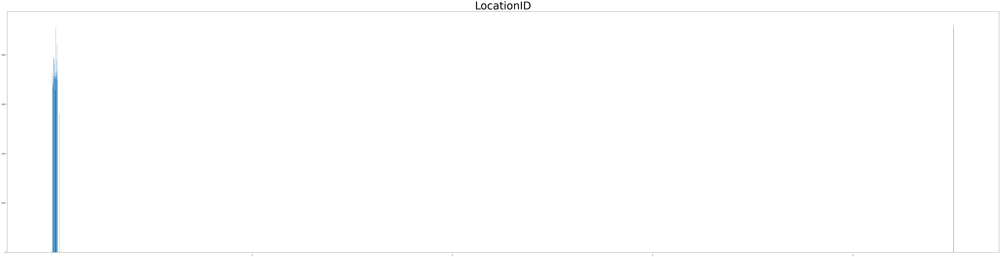

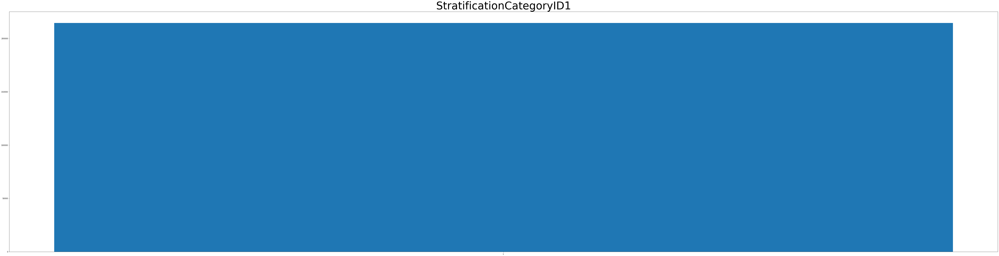

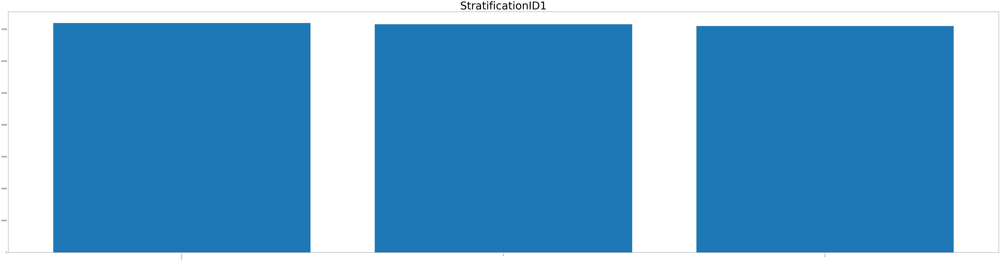

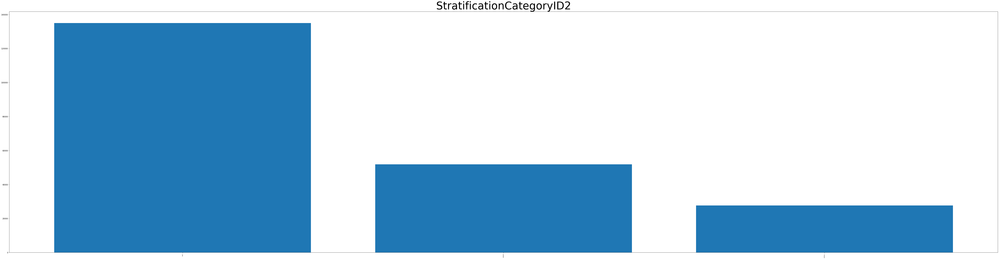

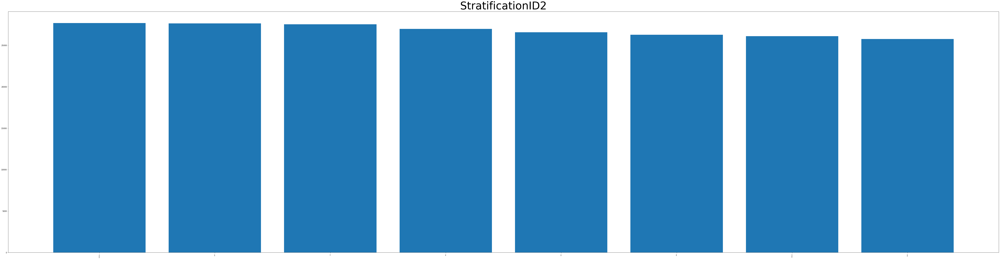

In [7]:
# 使用直方图、盒图等检查数据分布及离群点
# 绘制频数柱状图
for key in df1.columns:
    if not len(frequency[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency[key].name, fontsize=60)    
    plt.bar(frequency[key].index, frequency[key].values)
    plt.xticks(rotation=90, fontsize=5)
    plt.show()

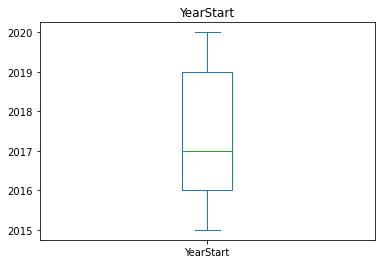

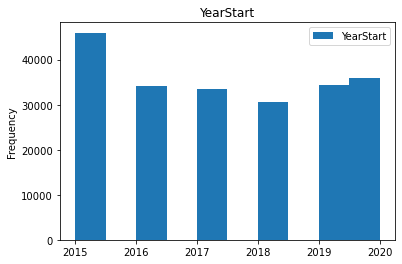

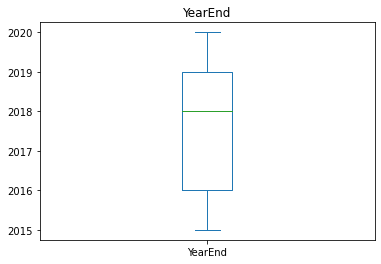

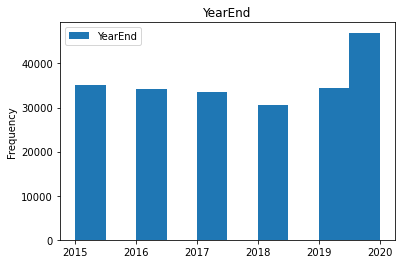

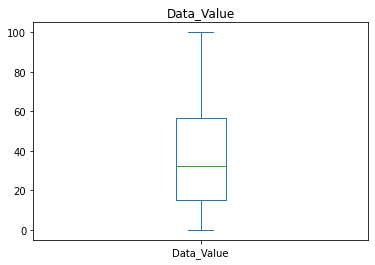

...

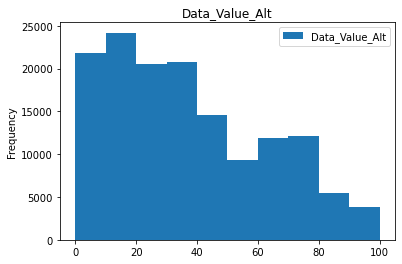

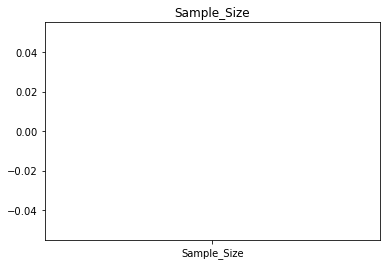

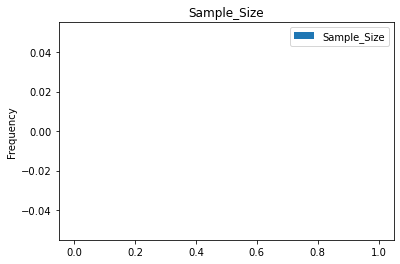

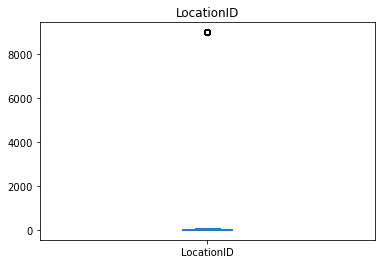

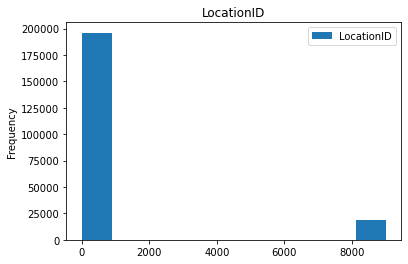

In [8]:
# 绘制数值属性直方图、盒图
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'Sample_Size', 'LocationID']  # 数值属性列
for key in numeric_keys:
    df1[[key]].plot(kind='box', title=key)
    df1[[key]].plot(kind='hist', title=key)

### 2. 数据缺失的处理
观察数据集中缺失数据，分析其缺失的原因。分别使用下列四种策略对缺失值进行处理。注意：在处理后完成，要对比新旧数据集的差异。

In [9]:
# 所有列缺失值数量
df1.isnull().sum(axis=0)

YearStart                         0
YearEnd                           0
LocationAbbr                      0
LocationDesc                      0
Datasource                        0
Class                             0
Topic                             0
Question                          0
Data_Value_Unit                   0
DataValueTypeID                   0
Data_Value_Type                   0
Data_Value                    69833
Data_Value_Alt                69833
Low_Confidence_Limit              0
High_Confidence_Limit             0
Sample_Size                  214462
StratificationCategory1           0
Stratification1                   0
StratificationCategory2       27669
Stratification2               27669
Geolocation                   23049
ClassID                           0
TopicID                           0
QuestionID                        0
LocationID                        0
StratificationCategoryID1         0
StratificationID1                 0
StratificationCategoryID2   

#### 2.1 将缺失部分剔除

In [10]:
df1_new = df1.drop(['Sample_Size'], axis=1, inplace=False).dropna(axis=0, inplace=False)  # Sample_Size列全部缺失，剔除
df1_new

,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,DataValueTypeID,...,Stratification2,Geolocation,ClassID,TopicID,QuestionID,LocationID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2
4,2020,2020,IN,Indiana,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-86.14996019 39.76691045),C05,TMC03,Q27,18,AGE,AGE_OVERALL,GENDER,MALE
8,2019,2019,IA,Iowa,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,Hispanic,POINT (-93.81649056 42.46940091),C01,TOC11,Q43,19,AGE,5064,RACE,HIS
11,2019,2019,KS,Kansas,BRFSS,Mental Health,Frequent mental distress,Percentage of older adults who are experiencin...,%,PRCTG,...,Hispanic,POINT (-98.20078123 38.3477403),C05,TMC01,Q03,20,AGE,AGE_OVERALL,RACE,HIS
15,2017,2017,KY,Kentucky,BRFSS,Overall Health,Recent activity limitations in past month,Mean number of days with activity limitations ...,Number,MEAN,...,Male,POINT (-84.77497105 37.64597027),C01,TOC03,Q35,21,AGE,AGE_OVERALL,GENDER,MALE
18,2020,2020,ME,Maine,BRFSS,Overall Health,Fair or poor health among older adults with ar...,Fair or poor health among older adults with do...,%,PRCTG,...,Female,POINT (-68.98503134 45.25422889),C01,TOC13,Q45,23,AGE,AGE_OVERALL,GENDER,FEMALE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214447,2019,2019,WY,Wyoming,BRFSS,Nutrition/Physical Activity/Obesity,No leisure-time physical activity within past ...,Percentage of older adults who have not had an...,%,PRCTG,...,Male,POINT (-108.1098304 43.23554134),C02,TNC03,Q16,56,AGE,5064,GENDER,MALE
214448,2016,2016,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"White, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56,AGE,65PLUS,RACE,WHT
214449,2019,2019,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,Female,POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56,AGE,65PLUS,GENDER,FEMALE
214452,2016,2016,WY,Wyoming,BRFSS,Overall Health,Self-rated health (good to excellent health),Percentage of older adults who self-reported t...,%,PRCTG,...,Female,POINT (-108.1098304 43.23554134),C01,TOC08,Q33,56,AGE,AGE_OVERALL,GENDER,FEMALE


In [11]:
# 对比新旧数据集的差异
print(df1.info())
print(df1_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214462 entries, 0 to 214461
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   YearStart                  214462 non-null  int64  
 1   YearEnd                    214462 non-null  int64  
 2   LocationAbbr               214462 non-null  object 
 3   LocationDesc               214462 non-null  object 
 4   Datasource                 214462 non-null  object 
 5   Class                      214462 non-null  object 
 6   Topic                      214462 non-null  object 
 7   Question                   214462 non-null  object 
 8   Data_Value_Unit            214462 non-null  object 
 9   DataValueTypeID            214462 non-null  object 
 10  Data_Value_Type            214462 non-null  object 
 11  Data_Value                 144629 non-null  float64
 12  Data_Value_Alt             144629 non-null  float64
 13  Low_Confidence_Limit       21

In [12]:
# 对比5数概括及缺失值的个数
# YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
describe1 = df1.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
min,2015.0,2015.0,0.0,0.0,NaN,1.0
25%,2016.0,2016.0,15.3,15.3,NaN,18.0
50%,2017.0,2018.0,32.5,32.5,NaN,33.0
75%,2019.0,2019.0,56.8,56.8,NaN,49.0
max,2020.0,2020.0,100.0,100.0,NaN,9004.0
NaN count,0.0,0.0,69833.0,69833.0,214462.0,0.0


In [13]:
# YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
describe1 = df1_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1_new.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
min,2015.0,2015.0,1.0,1.0,1.0
25%,2016.0,2016.0,15.5,15.5,16.0
50%,2017.0,2018.0,32.9,32.9,29.0
75%,2019.0,2019.0,57.4,57.4,42.0
max,2020.0,2020.0,99.9,99.9,78.0
NaN count,0.0,0.0,0.0,0.0,0.0


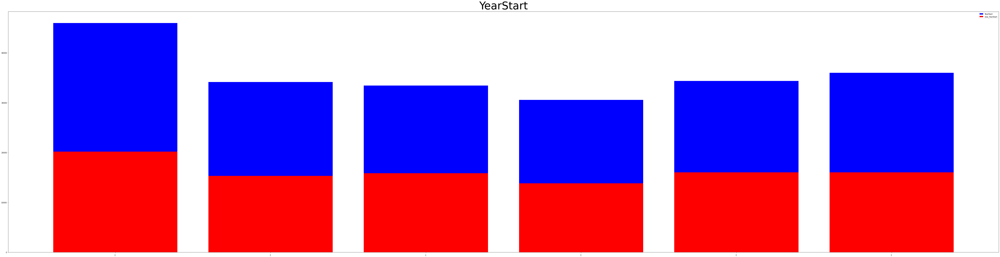

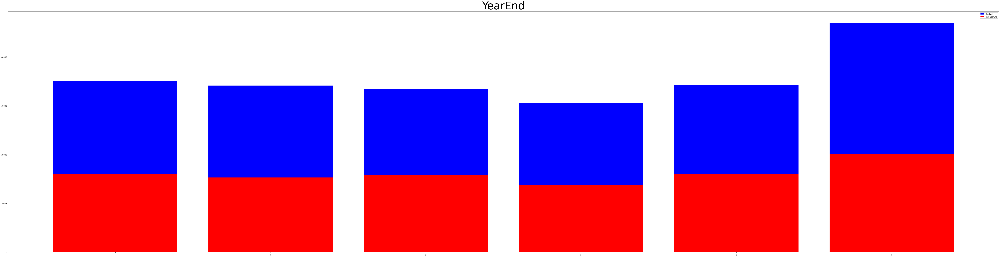

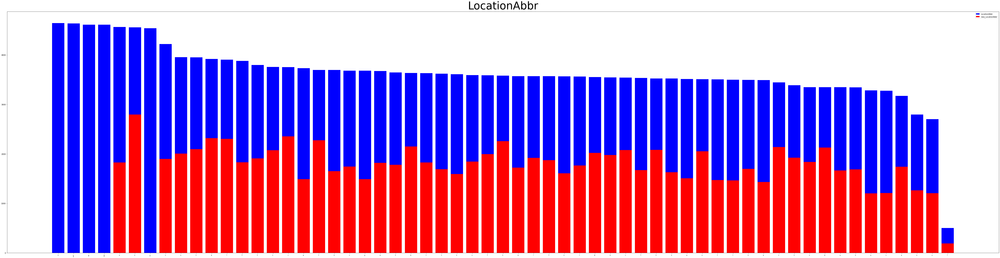

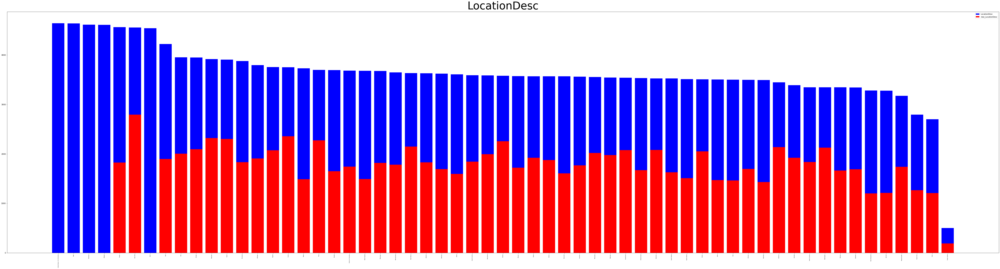

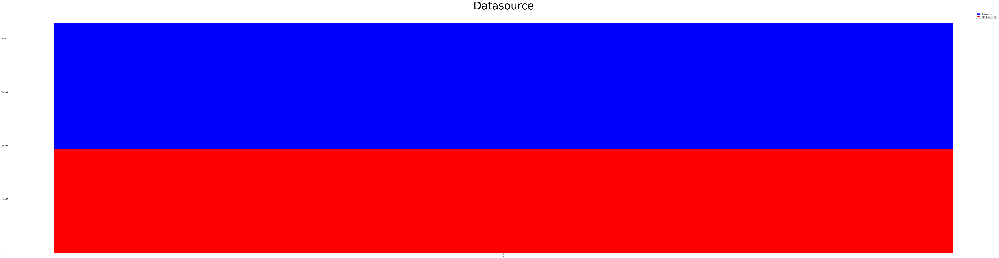

...

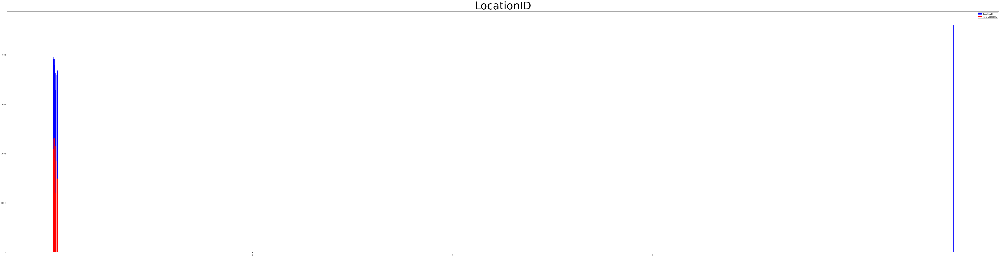

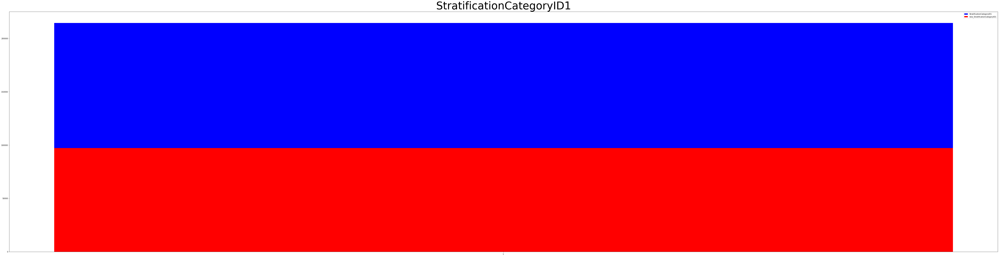

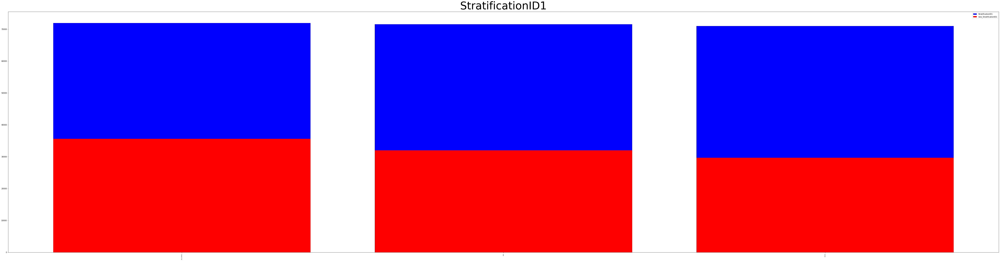

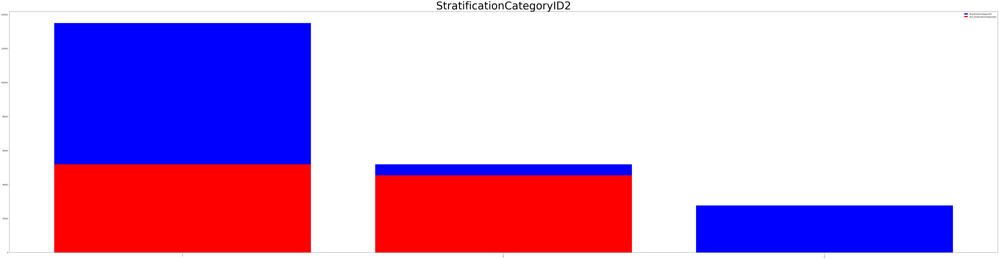

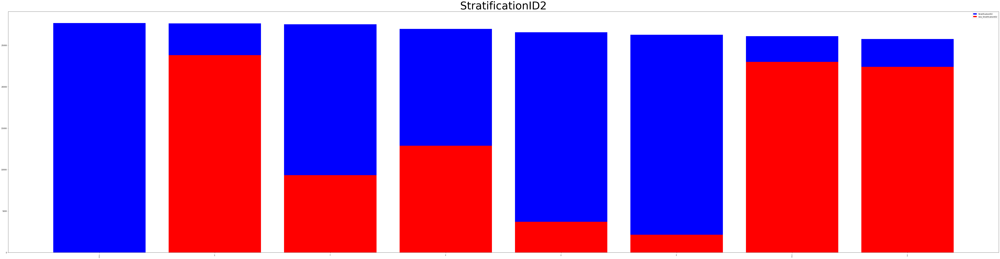

In [14]:
# 绘制频数柱状图对比
frequency_new = {key: df1_new[key].value_counts() for key in df1_new.columns}
for key in df1_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency[key].index, frequency[key].values,color='b',label=frequency[key].name)
    plt.bar(frequency_new[key].index, frequency_new[key].values,color='r',label='new_' + frequency_new[key].name)
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

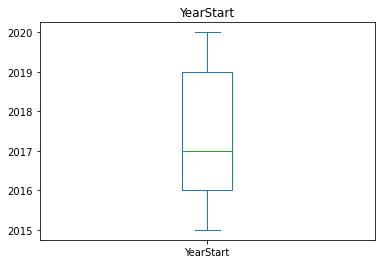

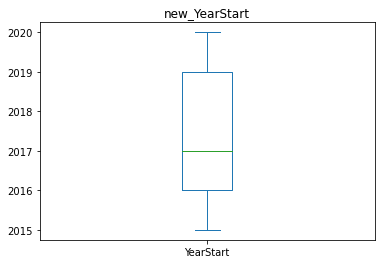

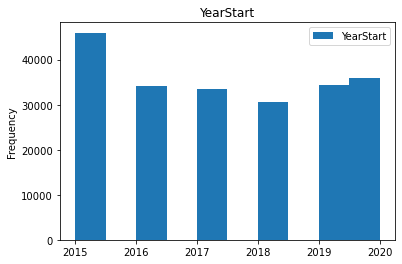

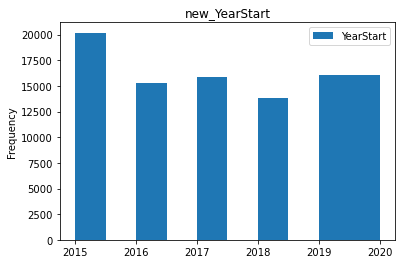

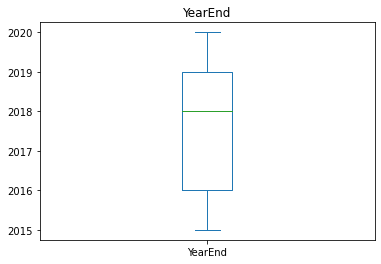

...

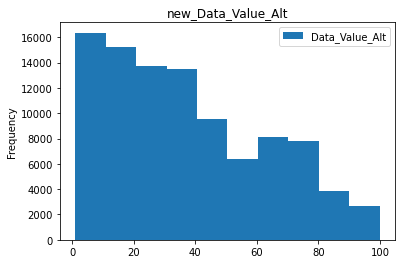

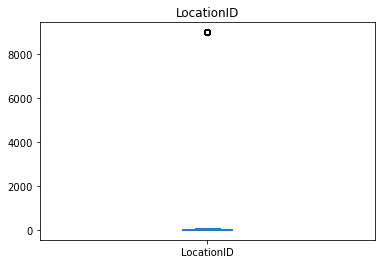

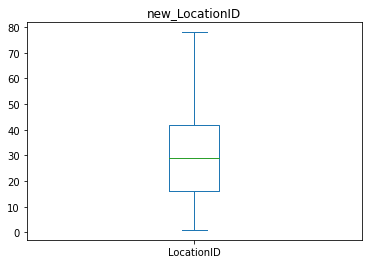

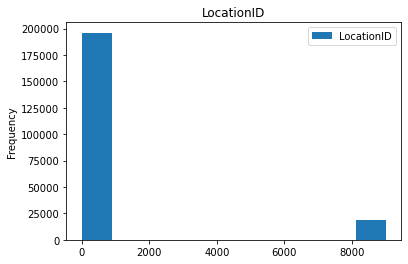

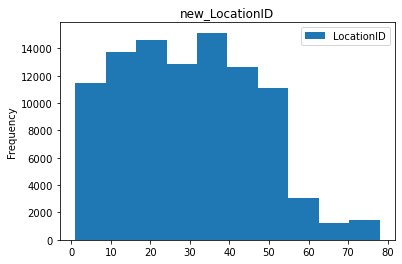

In [15]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'LocationID']  # 数值属性列
for key in numeric_keys:
    df1[[key]].plot(kind='box', title=key)
    df1_new[[key]].plot(kind='box', title='new_' + key)
    
    df1[[key]].plot(kind='hist', title=key)
    df1_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于将缺失部分剔除，数据条数减少了，因此数据分布发生了变化
#### 2.2 用最高频率值来填补缺失值

In [16]:
df1_new = df1.drop(['Sample_Size'], axis=1, inplace=False) 
for key in df1_new.columns:
    df1_new[key].fillna(df1_new[key].mode()[0],inplace=True)
df1_new

,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,DataValueTypeID,...,Stratification2,Geolocation,ClassID,TopicID,QuestionID,LocationID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2
0,2020,2020,HI,Hawaii,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,"White, non-Hispanic",POINT (-157.8577494 21.30485044),C01,TOC11,Q43,15,AGE,5064,OVERALL,OVERALL
1,2017,2017,ID,Idaho,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,"White, non-Hispanic",POINT (-114.36373 43.68263001),C05,TMC03,Q27,16,AGE,5064,OVERALL,OVERALL
2,2017,2017,ID,Idaho,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,"White, non-Hispanic",POINT (-114.36373 43.68263001),C01,TOC11,Q43,16,AGE,5064,OVERALL,OVERALL
3,2018,2018,ID,Idaho,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"White, non-Hispanic",POINT (-114.36373 43.68263001),C01,TOC01,Q08,16,AGE,5064,OVERALL,OVERALL
4,2020,2020,IN,Indiana,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-86.14996019 39.76691045),C05,TMC03,Q27,18,AGE,AGE_OVERALL,GENDER,MALE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214457,2016,2016,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"Black, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56,AGE,5064,RACE,BLK
214458,2015,2015,WY,Wyoming,BRFSS,Smoking and Alcohol Use,Current smoking,Percentage of older adults who have smoked at ...,%,PRCTG,...,Asian/Pacific Islander,POINT (-108.1098304 43.23554134),C04,TAC01,Q17,56,AGE,65PLUS,RACE,ASN
214459,2017,2017,WY,Wyoming,BRFSS,Overall Health,Self-rated health (fair to poor health),Percentage of older adults who self-reported t...,%,PRCTG,...,Native Am/Alaskan Native,POINT (-108.1098304 43.23554134),C01,TOC07,Q32,56,AGE,AGE_OVERALL,RACE,NAA
214460,2016,2016,WY,Wyoming,BRFSS,Overall Health,Fall with injury within last year,Percentage of older adults who have fallen and...,%,PRCTG,...,"White, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC06,Q05,56,AGE,5064,OVERALL,OVERALL


In [17]:
# 对比新旧数据集的差异
print(df1.info())
print(df1_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214462 entries, 0 to 214461
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   YearStart                  214462 non-null  int64  
 1   YearEnd                    214462 non-null  int64  
 2   LocationAbbr               214462 non-null  object 
 3   LocationDesc               214462 non-null  object 
 4   Datasource                 214462 non-null  object 
 5   Class                      214462 non-null  object 
 6   Topic                      214462 non-null  object 
 7   Question                   214462 non-null  object 
 8   Data_Value_Unit            214462 non-null  object 
 9   DataValueTypeID            214462 non-null  object 
 10  Data_Value_Type            214462 non-null  object 
 11  Data_Value                 144629 non-null  float64
 12  Data_Value_Alt             144629 non-null  float64
 13  Low_Confidence_Limit       21

In [18]:
# 对比5数概括及缺失值的个数
# YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
describe1 = df1.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
min,2015.0,2015.0,0.0,0.0,NaN,1.0
25%,2016.0,2016.0,15.3,15.3,NaN,18.0
50%,2017.0,2018.0,32.5,32.5,NaN,33.0
75%,2019.0,2019.0,56.8,56.8,NaN,49.0
max,2020.0,2020.0,100.0,100.0,NaN,9004.0
NaN count,0.0,0.0,69833.0,69833.0,214462.0,0.0


In [19]:
# YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
describe1 = df1_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1_new.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
min,2015.0,2015.0,0.0,0.0,1.0
25%,2016.0,2016.0,6.0,6.0,18.0
50%,2017.0,2018.0,15.9,15.9,33.0
75%,2019.0,2019.0,42.1,42.1,49.0
max,2020.0,2020.0,100.0,100.0,9004.0
NaN count,0.0,0.0,0.0,0.0,0.0


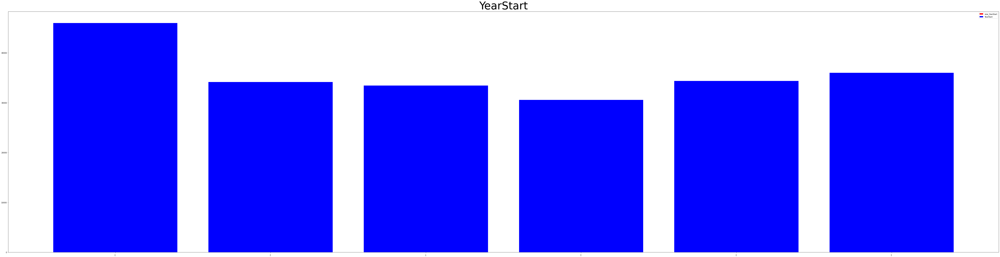

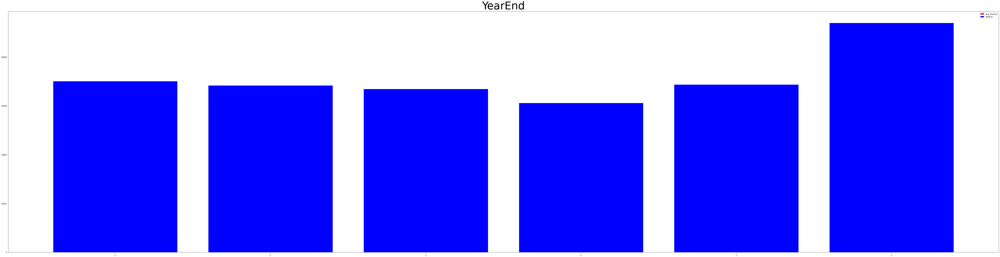

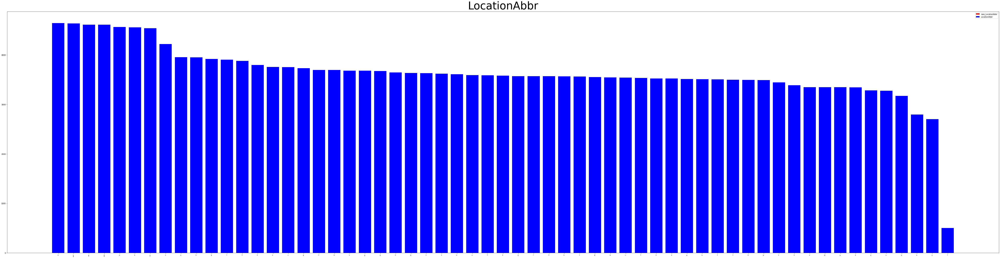

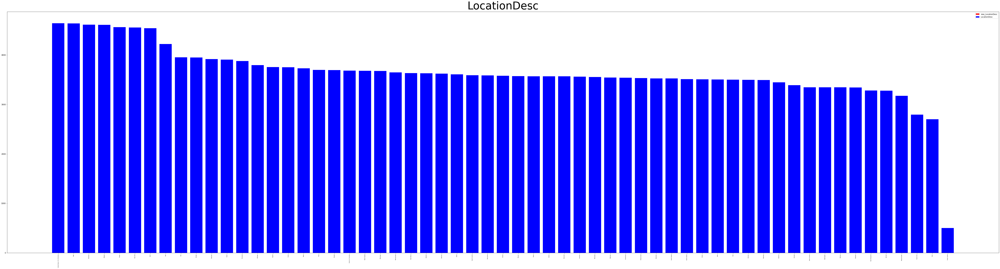

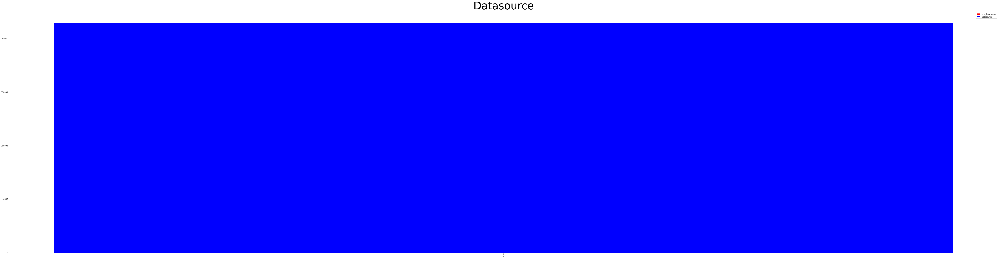

...

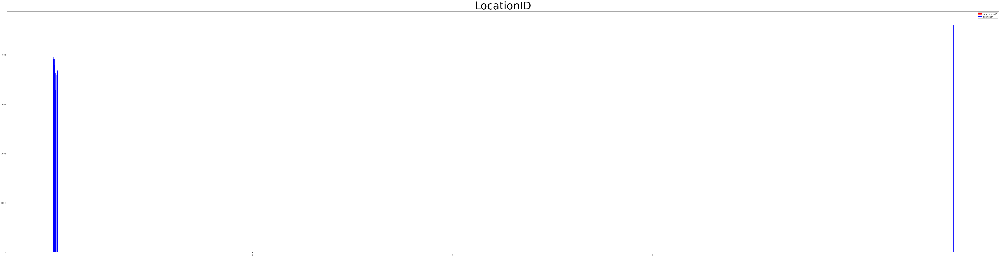

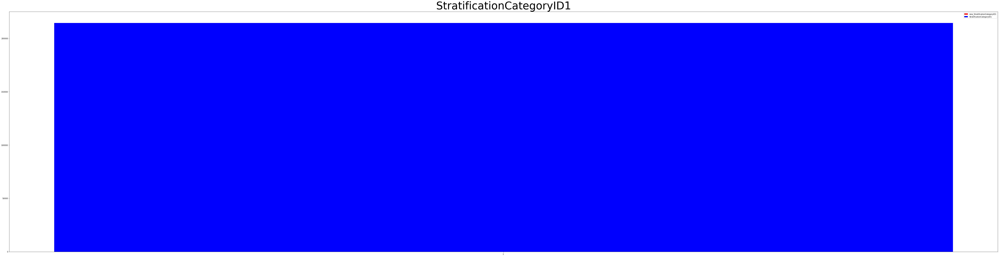

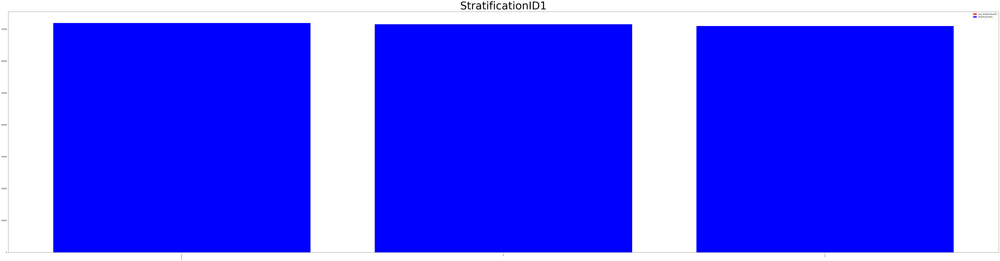

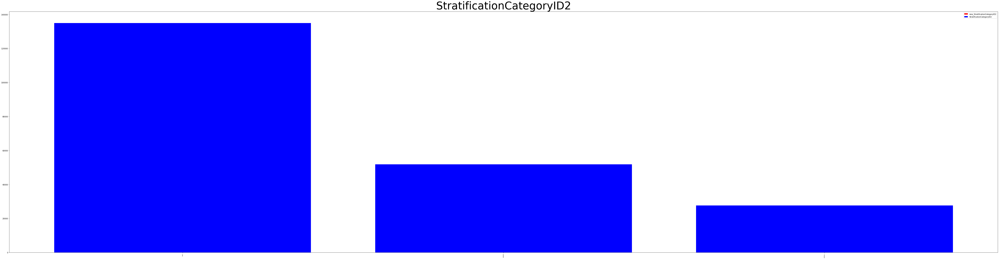

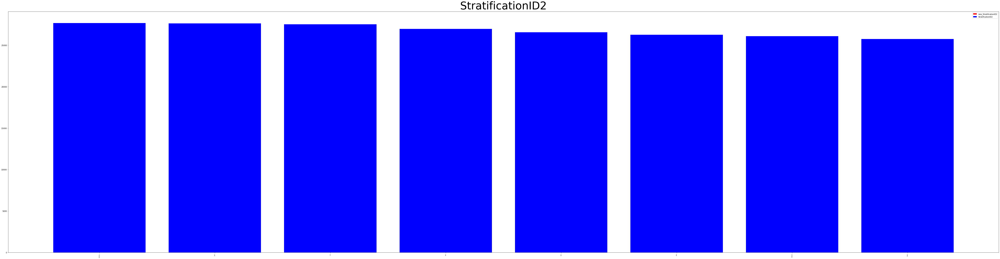

In [20]:
# 绘制频数柱状图对比
frequency_new = {key: df1_new[key].value_counts() for key in df1_new.columns}
for key in df1_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index, frequency_new[key].values,color='r',label='new_' + frequency_new[key].name)
    plt.bar(frequency[key].index, frequency[key].values,color='b',label=frequency[key].name)
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

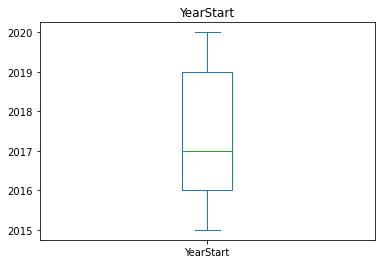

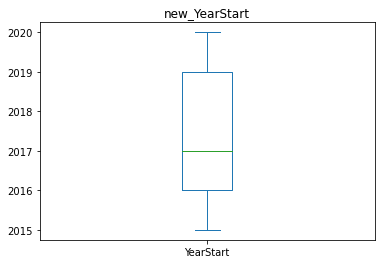

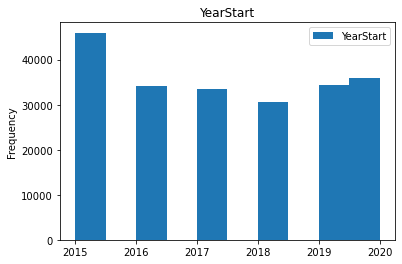

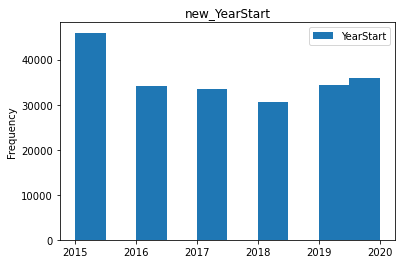

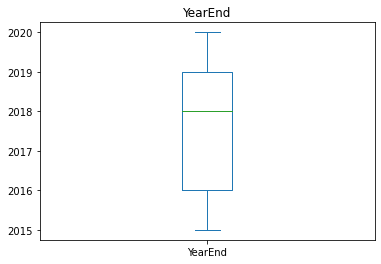

...

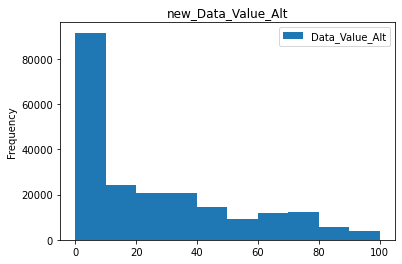

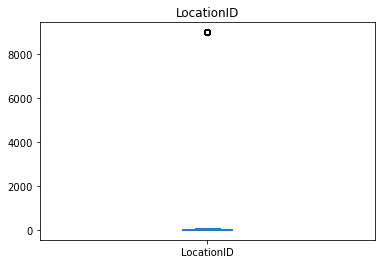

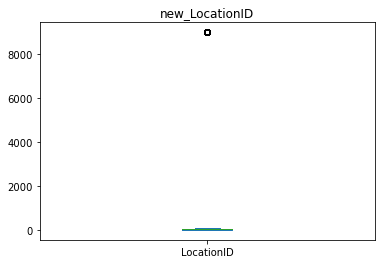

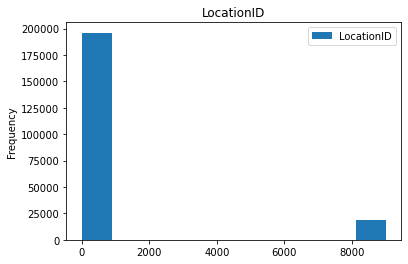

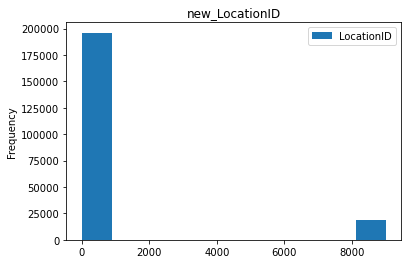

In [21]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'LocationID']  # 数值属性列
for key in numeric_keys:
    df1[[key]].plot(kind='box', title=key)
    df1_new[[key]].plot(kind='box', title='new_' + key)
    
    df1[[key]].plot(kind='hist', title=key)
    df1_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于用最高频率值来填补缺失值，频数高的数据数量增多，因此数据分布发生了变化
#### 2.3 通过属性的相关关系来填补缺失值

In [22]:
miss_columns = ['Data_Value', 'Data_Value_Alt', 'StratificationCategory2', 'Stratification2', 'Geolocation']
comp_columns = ['LocationID', 'YearStart', 'StratificationID1', 'Datasource', 'Data_Value_Type', 'Class', 'StratificationID2', 
                'Question', 'LocationAbbr', 'High_Confidence_Limit', 'Data_Value_Unit', 'StratificationCategoryID2', 
                'Low_Confidence_Limit', 'QuestionID', 'LocationDesc', 'DataValueTypeID', 'ClassID', 'StratificationCategoryID1', 
                'StratificationCategory1', 'YearEnd', 'Topic', 'Stratification1', 'TopicID']
df1_new = df1.drop(['Sample_Size'], axis=1, inplace=False) 
for miss_column in miss_columns:
    comp_columns.insert(0, miss_column)
    
    enc_label = OrdinalEncoder()
    enc_fea = OrdinalEncoder()
    miss_index = comp_columns[0]
    
    # 选择数值属性用来计算随机森林
    train_df = df1_new[comp_columns]
    known_values = np.array(train_df[train_df[miss_index].notnull()])
    unknow_values = np.array(train_df[train_df[miss_index].isnull()])
    
    # Y是缺失值
    y = known_values[:, 0].reshape(-1, 1)
    enc_label.fit(y)
    y = enc_label.transform(y)
    
    # X是特征值
    X = known_values[:, 1:]
    test_X = unknow_values[:, 1:]
    all_X = np.row_stack((X,test_X))
    enc_fea.fit(all_X)
    X = enc_fea.transform(X)
    
    # 拟合
    rfr = RandomForestRegressor(n_estimators=10)
    rfr.fit(X, y.ravel())
    # 预测
    predicted_values = rfr.predict(enc_fea.transform(unknow_values[:, 1:]))
    predicted_values = enc_label.inverse_transform(predicted_values.reshape(-1, 1))
    # 填充预测值
    df1_new.loc[(df1_new[miss_index].isnull()), miss_index] = predicted_values
df1_new

,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,DataValueTypeID,...,Stratification2,Geolocation,ClassID,TopicID,QuestionID,LocationID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2
0,2020,2020,HI,Hawaii,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,Male,POINT (-157.8577494 21.30485044),C01,TOC11,Q43,15,AGE,5064,OVERALL,OVERALL
1,2017,2017,ID,Idaho,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-114.36373 43.68263001),C05,TMC03,Q27,16,AGE,5064,OVERALL,OVERALL
2,2017,2017,ID,Idaho,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,Male,POINT (-114.36373 43.68263001),C01,TOC11,Q43,16,AGE,5064,OVERALL,OVERALL
3,2018,2018,ID,Idaho,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,Male,POINT (-114.36373 43.68263001),C01,TOC01,Q08,16,AGE,5064,OVERALL,OVERALL
4,2020,2020,IN,Indiana,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-86.14996019 39.76691045),C05,TMC03,Q27,18,AGE,AGE_OVERALL,GENDER,MALE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214457,2016,2016,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"Black, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56,AGE,5064,RACE,BLK
214458,2015,2015,WY,Wyoming,BRFSS,Smoking and Alcohol Use,Current smoking,Percentage of older adults who have smoked at ...,%,PRCTG,...,Asian/Pacific Islander,POINT (-108.1098304 43.23554134),C04,TAC01,Q17,56,AGE,65PLUS,RACE,ASN
214459,2017,2017,WY,Wyoming,BRFSS,Overall Health,Self-rated health (fair to poor health),Percentage of older adults who self-reported t...,%,PRCTG,...,Native Am/Alaskan Native,POINT (-108.1098304 43.23554134),C01,TOC07,Q32,56,AGE,AGE_OVERALL,RACE,NAA
214460,2016,2016,WY,Wyoming,BRFSS,Overall Health,Fall with injury within last year,Percentage of older adults who have fallen and...,%,PRCTG,...,Male,POINT (-108.1098304 43.23554134),C01,TOC06,Q05,56,AGE,5064,OVERALL,OVERALL


In [23]:
# 对比新旧数据集的差异
print(df1.info())
print(df1_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214462 entries, 0 to 214461
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   YearStart                  214462 non-null  int64  
 1   YearEnd                    214462 non-null  int64  
 2   LocationAbbr               214462 non-null  object 
 3   LocationDesc               214462 non-null  object 
 4   Datasource                 214462 non-null  object 
 5   Class                      214462 non-null  object 
 6   Topic                      214462 non-null  object 
 7   Question                   214462 non-null  object 
 8   Data_Value_Unit            214462 non-null  object 
 9   DataValueTypeID            214462 non-null  object 
 10  Data_Value_Type            214462 non-null  object 
 11  Data_Value                 144629 non-null  float64
 12  Data_Value_Alt             144629 non-null  float64
 13  Low_Confidence_Limit       21

In [24]:
# 对比5数概括及缺失值的个数
# YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
describe1 = df1.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
min,2015.0,2015.0,0.0,0.0,NaN,1.0
25%,2016.0,2016.0,15.3,15.3,NaN,18.0
50%,2017.0,2018.0,32.5,32.5,NaN,33.0
75%,2019.0,2019.0,56.8,56.8,NaN,49.0
max,2020.0,2020.0,100.0,100.0,NaN,9004.0
NaN count,0.0,0.0,69833.0,69833.0,214462.0,0.0


In [25]:
# YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
describe1 = df1_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1_new.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
min,2015.0,2015.0,0.0,0.0,1.0
25%,2016.0,2016.0,10.4,10.4,18.0
50%,2017.0,2018.0,33.7,33.7,33.0
75%,2019.0,2019.0,70.2,70.2,49.0
max,2020.0,2020.0,100.0,100.0,9004.0
NaN count,0.0,0.0,0.0,0.0,0.0


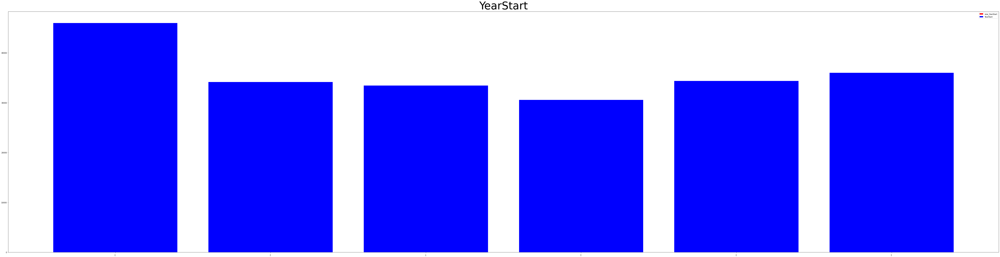

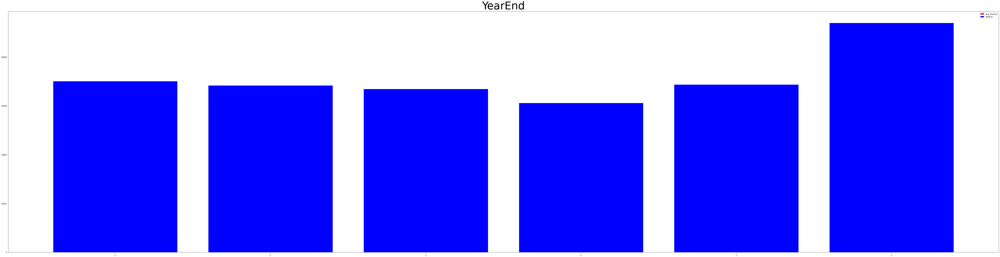

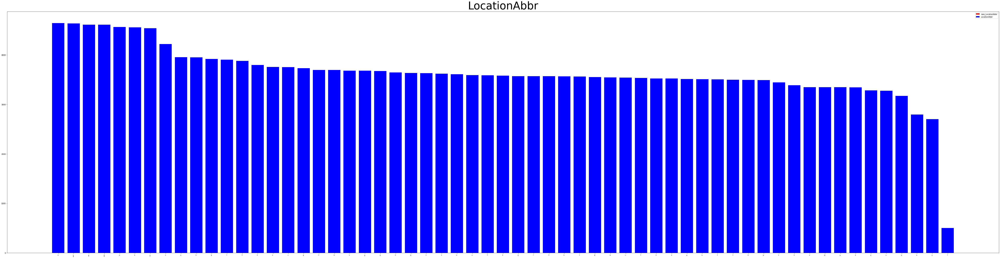

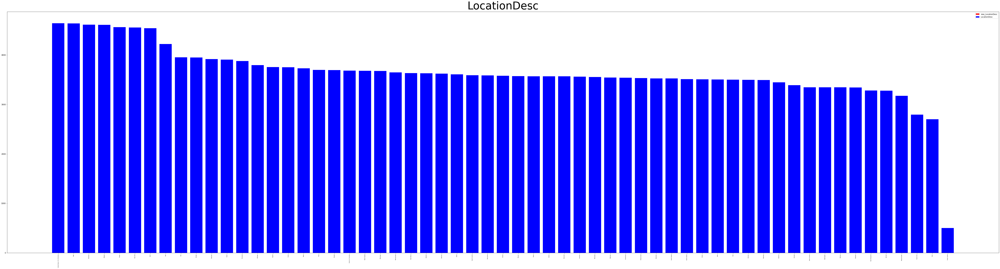

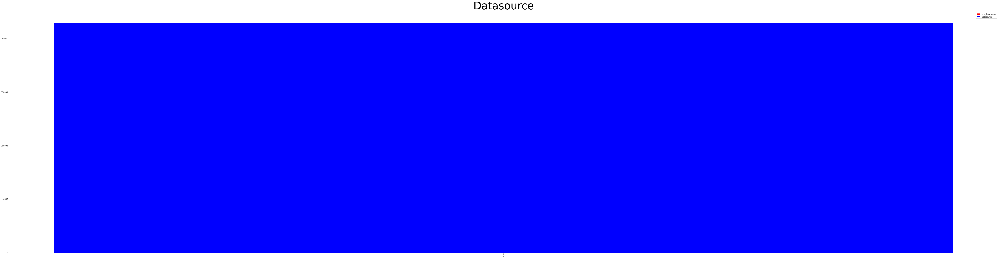

...

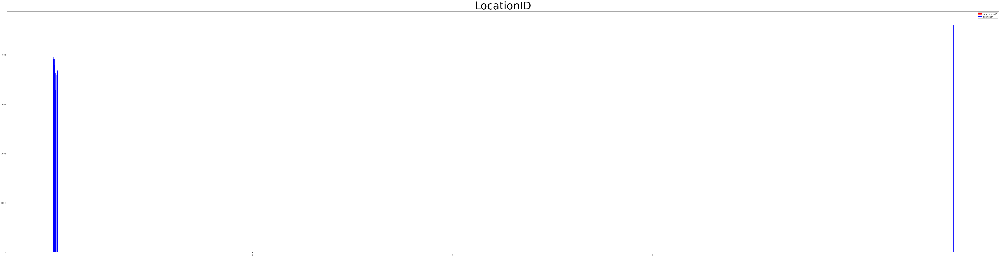

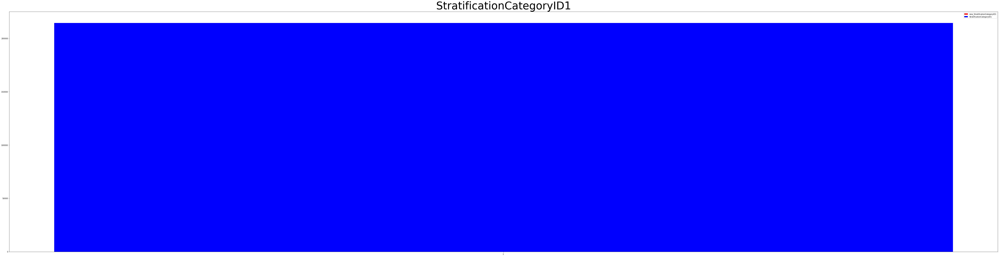

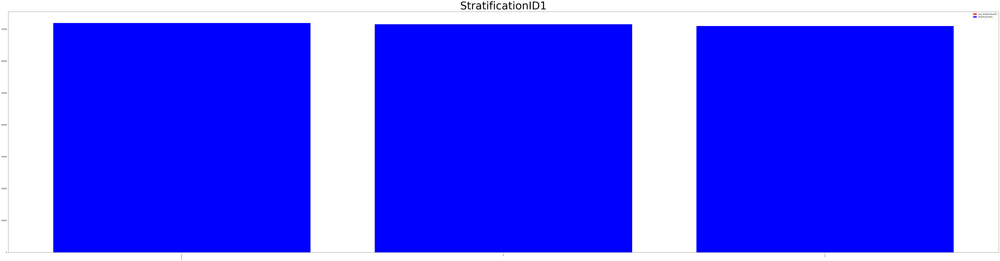

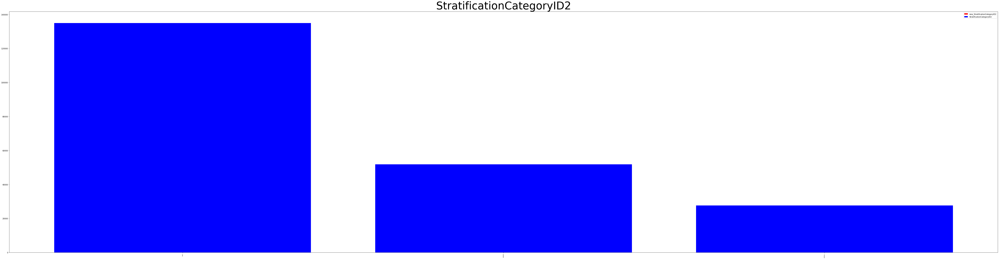

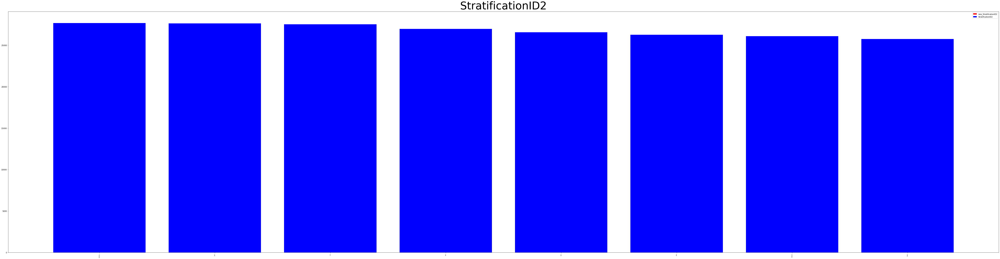

In [26]:
# 绘制频数柱状图对比
frequency_new = {key: df1_new[key].value_counts() for key in df1_new.columns}
for key in df1_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index, frequency_new[key].values,color='r',label='new_' + frequency_new[key].name)
    plt.bar(frequency[key].index, frequency[key].values,color='b',label=frequency[key].name)
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

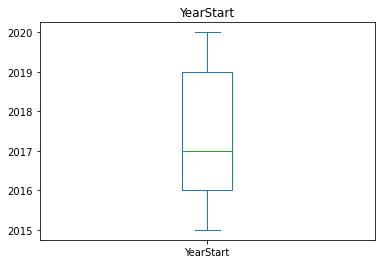

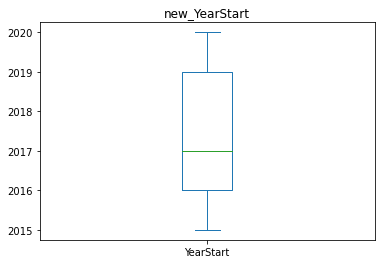

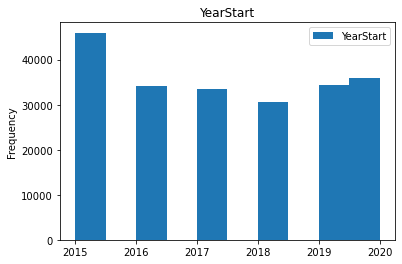

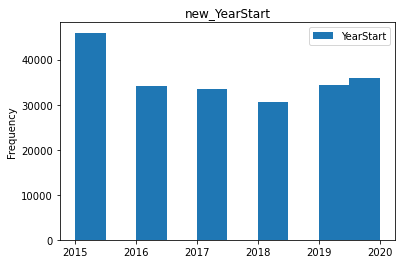

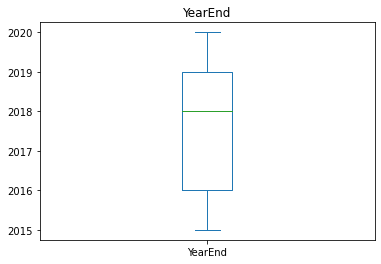

...

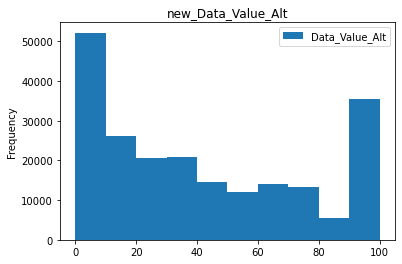

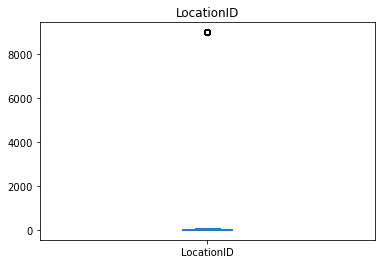

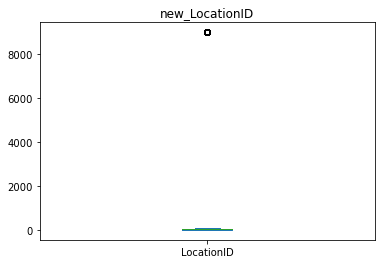

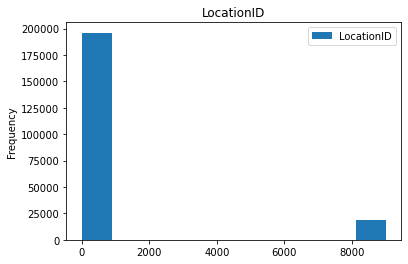

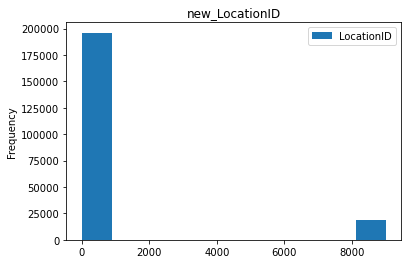

In [27]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'LocationID']  # 数值属性列
for key in numeric_keys:
    df1[[key]].plot(kind='box', title=key)
    df1_new[[key]].plot(kind='box', title='new_' + key)
    
    df1[[key]].plot(kind='hist', title=key)
    df1_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于通过属性的相关关系来填补缺失值，相关性高的数据频数增多，因此数据分布发生了变化
#### 2.4 通过数据对象之间的相似性来填补缺失值

In [28]:
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'LocationID']  # 数值属性列
sys.setrecursionlimit(10000)
df1_new = df1.drop(['Sample_Size'], axis=1, inplace=False)
imputed_training=fast_knn(df1_new[numeric_keys].values, k=10)
imputed_training=pd.DataFrame(data=imputed_training,columns=numeric_keys)
df1_new[numeric_keys] = imputed_training[numeric_keys]
df1_new

D:\Anaconda3\lib\site-packages\impyute\imputation\cs\fast_knn.py:113: RuntimeWarning: invalid value encountered in true_divide
  weights = distances/np.sum(distances)


,YearStart,YearEnd,LocationAbbr,LocationDesc,Datasource,Class,Topic,Question,Data_Value_Unit,DataValueTypeID,...,Stratification2,Geolocation,ClassID,TopicID,QuestionID,LocationID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2
0,2020.0,2020.0,HI,Hawaii,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,NaN,POINT (-157.8577494 21.30485044),C01,TOC11,Q43,15.0,AGE,5064,OVERALL,OVERALL
1,2017.0,2017.0,ID,Idaho,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,NaN,POINT (-114.36373 43.68263001),C05,TMC03,Q27,16.0,AGE,5064,OVERALL,OVERALL
2,2017.0,2017.0,ID,Idaho,BRFSS,Overall Health,Arthritis among older adults,Percentage of older adults ever told they have...,%,PRCTG,...,NaN,POINT (-114.36373 43.68263001),C01,TOC11,Q43,16.0,AGE,5064,OVERALL,OVERALL
3,2018.0,2018.0,ID,Idaho,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,NaN,POINT (-114.36373 43.68263001),C01,TOC01,Q08,16.0,AGE,5064,OVERALL,OVERALL
4,2020.0,2020.0,IN,Indiana,BRFSS,Mental Health,Lifetime diagnosis of depression,Percentage of older adults with a lifetime dia...,%,PRCTG,...,Male,POINT (-86.14996019 39.76691045),C05,TMC03,Q27,18.0,AGE,AGE_OVERALL,GENDER,MALE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214457,2016.0,2016.0,WY,Wyoming,BRFSS,Overall Health,Physically unhealthy days (mean number of days),Physically unhealthy days (mean number of days...,Number,MEAN,...,"Black, non-Hispanic",POINT (-108.1098304 43.23554134),C01,TOC01,Q08,56.0,AGE,5064,RACE,BLK
214458,2015.0,2015.0,WY,Wyoming,BRFSS,Smoking and Alcohol Use,Current smoking,Percentage of older adults who have smoked at ...,%,PRCTG,...,Asian/Pacific Islander,POINT (-108.1098304 43.23554134),C04,TAC01,Q17,56.0,AGE,65PLUS,RACE,ASN
214459,2017.0,2017.0,WY,Wyoming,BRFSS,Overall Health,Self-rated health (fair to poor health),Percentage of older adults who self-reported t...,%,PRCTG,...,Native Am/Alaskan Native,POINT (-108.1098304 43.23554134),C01,TOC07,Q32,56.0,AGE,AGE_OVERALL,RACE,NAA
214460,2016.0,2016.0,WY,Wyoming,BRFSS,Overall Health,Fall with injury within last year,Percentage of older adults who have fallen and...,%,PRCTG,...,NaN,POINT (-108.1098304 43.23554134),C01,TOC06,Q05,56.0,AGE,5064,OVERALL,OVERALL


In [29]:
# 对比新旧数据集的差异
print(df1.info())
print(df1_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 214462 entries, 0 to 214461
Data columns (total 29 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   YearStart                  214462 non-null  int64  
 1   YearEnd                    214462 non-null  int64  
 2   LocationAbbr               214462 non-null  object 
 3   LocationDesc               214462 non-null  object 
 4   Datasource                 214462 non-null  object 
 5   Class                      214462 non-null  object 
 6   Topic                      214462 non-null  object 
 7   Question                   214462 non-null  object 
 8   Data_Value_Unit            214462 non-null  object 
 9   DataValueTypeID            214462 non-null  object 
 10  Data_Value_Type            214462 non-null  object 
 11  Data_Value                 144629 non-null  float64
 12  Data_Value_Alt             144629 non-null  float64
 13  Low_Confidence_Limit       21

In [30]:
# 对比5数概括及缺失值的个数
# YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
describe1 = df1.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,Sample_Size,LocationID
min,2015.0,2015.0,0.0,0.0,NaN,1.0
25%,2016.0,2016.0,15.3,15.3,NaN,18.0
50%,2017.0,2018.0,32.5,32.5,NaN,33.0
75%,2019.0,2019.0,56.8,56.8,NaN,49.0
max,2020.0,2020.0,100.0,100.0,NaN,9004.0
NaN count,0.0,0.0,69833.0,69833.0,214462.0,0.0


In [31]:
# YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
describe1 = df1_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe1.loc['NaN count'] = df1_new.shape[0]  - describe1.loc['count'].values
describe1.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,YearStart,YearEnd,Data_Value,Data_Value_Alt,LocationID
min,2015.0,2015.0,0.0,0.0,1.0
25%,2016.0,2016.0,15.5,15.5,18.0
50%,2017.0,2018.0,33.0,33.0,33.0
75%,2019.0,2019.0,56.3,56.3,49.0
max,2020.0,2020.0,100.0,100.0,9004.0
NaN count,0.0,0.0,67662.0,67662.0,0.0


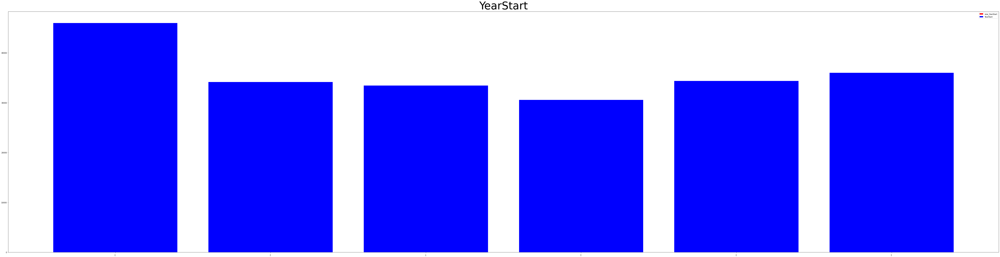

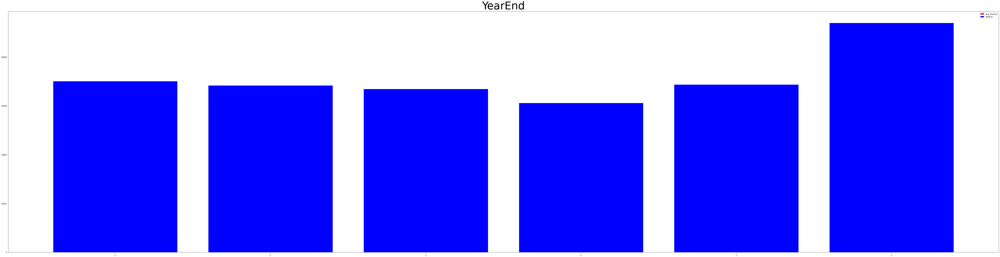

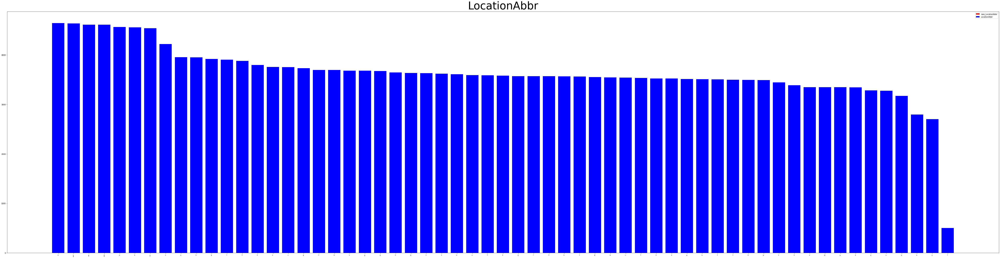

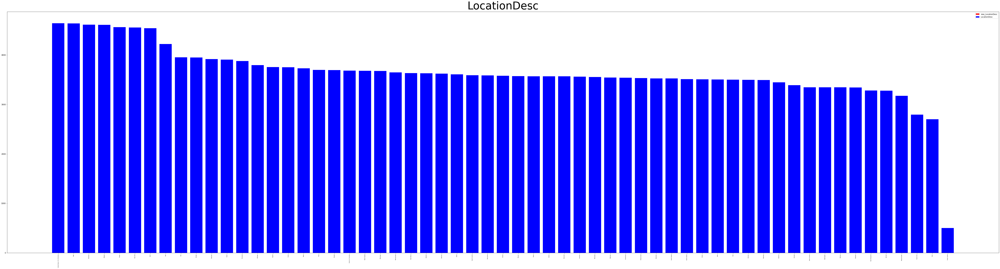

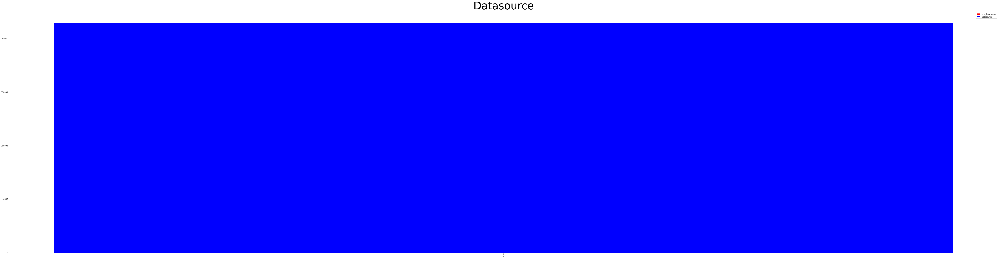

...

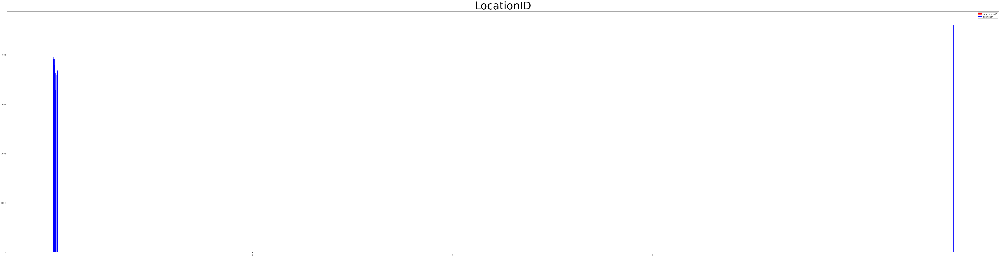

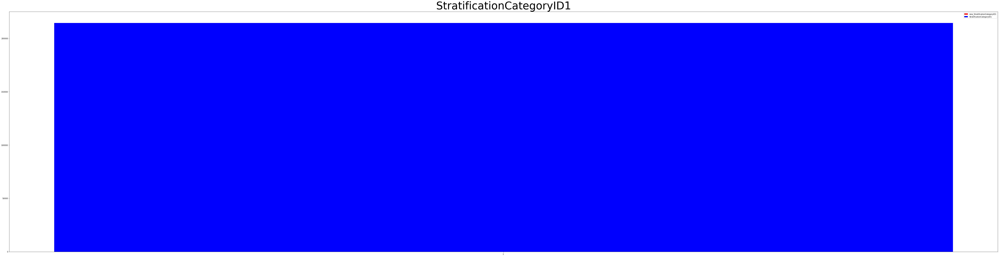

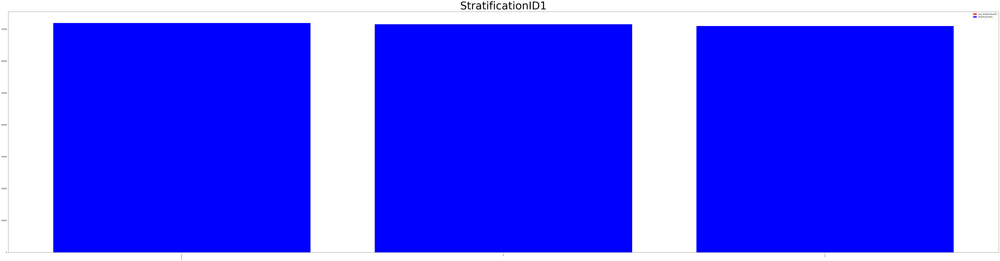

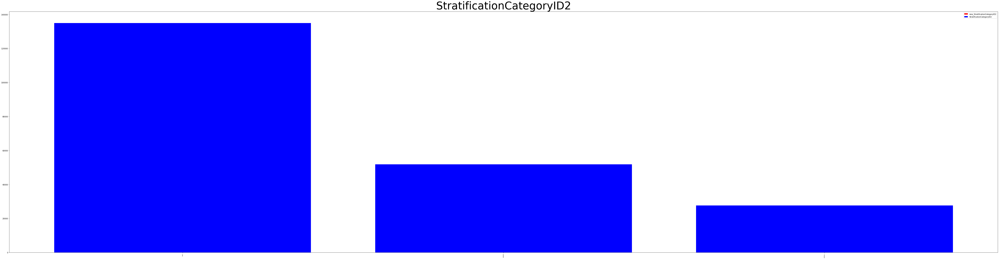

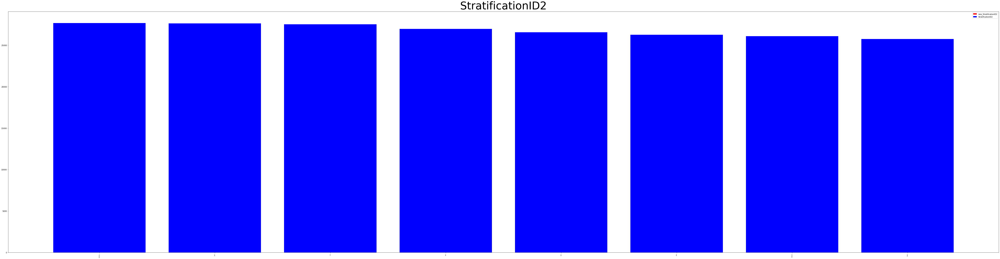

In [32]:
# 绘制频数柱状图对比
frequency_new = {key: df1_new[key].value_counts() for key in df1_new.columns}
for key in df1_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index, frequency_new[key].values,color='r',label='new_' + frequency_new[key].name)
    plt.bar(frequency[key].index, frequency[key].values,color='b',label=frequency[key].name)
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

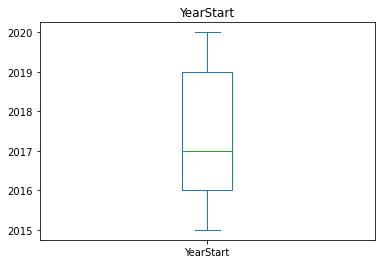

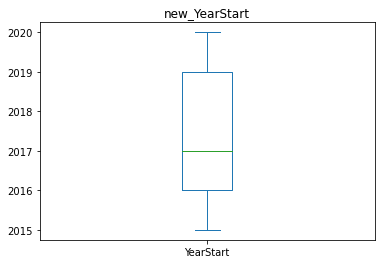

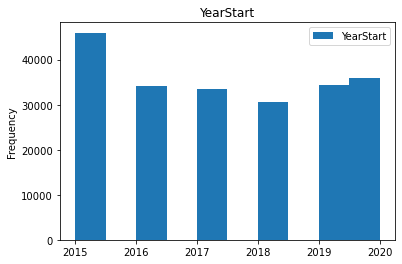

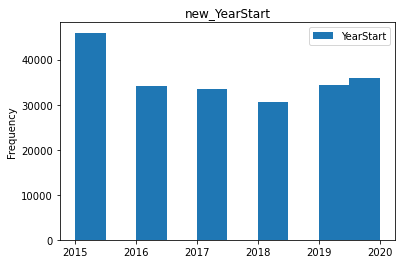

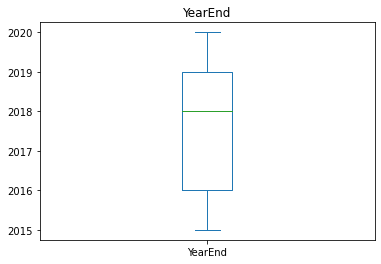

...

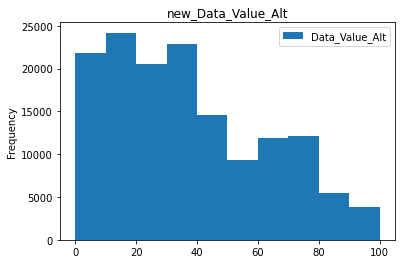

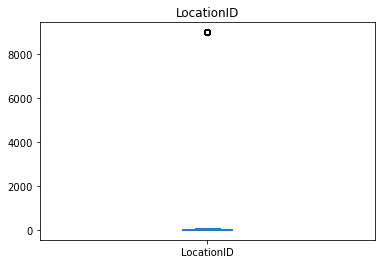

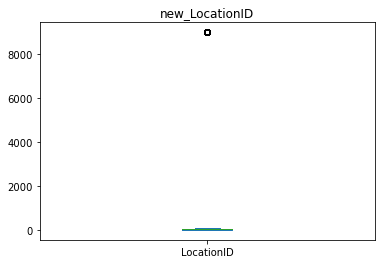

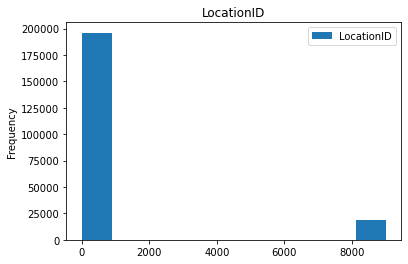

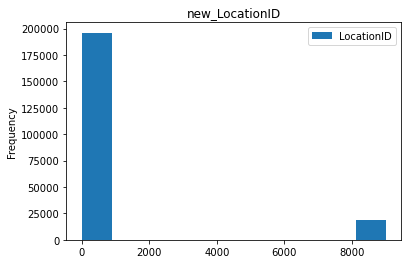

In [33]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['YearStart','YearEnd', 'Data_Value', 'Data_Value_Alt', 'LocationID']  # 数值属性列
for key in numeric_keys:
    df1[[key]].plot(kind='box', title=key)
    df1_new[[key]].plot(kind='box', title='new_' + key)
    
    df1[[key]].plot(kind='hist', title=key)
    df1_new[[key]].plot(kind='hist', title='new_' + key)

## 数据集2-Movies Dataset from Pirated Sites
"Movie'e dataset gathered from a pirated downloading website."

In [34]:
# # 加载Movies Dataset from Pirated Sites
df2 = pd.read_csv("./movies_dataset.csv")
df2

,Unnamed: 0,IMDb-rating,appropriate_for,director,downloads,id,industry,language,posted_date,release_date,run_time,storyline,title,views,writer
0,0,4.8,R,John Swab,304,372092,Hollywood / English,English,"20 Feb, 2023",Jan 28 2023,105,Doc\r\n facilitates a fragile truce between th...,Little Dixie,"2,794",John Swab
1,1,6.4,TV-PG,Paul Ziller,73,372091,Hollywood / English,English,"20 Feb, 2023",Feb 05 2023,84,Caterer\r\n Goldy Berry reunites with detectiv...,Grilling Season: A Curious Caterer Mystery,"1,002",John Christian Plummer
2,2,5.2,R,Ben Wheatley,"1,427",343381,Hollywood / English,"English,Hindi","20 Apr, 2021",Jun 18 2021,1h 47min,As the world searches for a cure to a disastro...,In the Earth,"14,419",Ben Wheatley
3,3,8.1,NaN,Venky Atluri,"1,549",372090,Tollywood,Hindi,"20 Feb, 2023",Feb 17 2023,139,The life of a young man and his struggles agai...,Vaathi,"4,878",Venky Atluri
4,4,4.6,NaN,Shaji Kailas,657,372089,Tollywood,Hindi,"20 Feb, 2023",Jan 26 2023,122,A man named Kalidas gets stranded due to the p...,Alone,"2,438",Rajesh Jayaraman
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20543,20543,NaN,NaN,NaN,"1,998",28957,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 13 1959,NaN,NaN,Bhai-Bahen,"6,219",NaN
20544,20544,7.7,NaN,Bimal Roy,"6,080",28958,Bollywood / Indian,Hindi,"01 Jan, 1970",May 13 1955,159,Devdas and Parvati had been inseparable as chi...,Devdas,"16,376","Rajinder Singh Bedi, Saratchandra Chatterjee, ..."
20545,20545,8.0,NaN,NaN,"3,276",30459,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 28 1958,1h 50min,"While driving his car on a rainy night, Anand'...",Madhumati,"7,220",NaN
20546,20546,NaN,NaN,NaN,309,371669,Wrestling,English,"10 Feb, 2023",Feb 09 2023,NaN,NaN,TNA.Impact 2023-02-09,"1,419",NaN


In [35]:
# 数据集各列属性
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20548 entries, 0 to 20547
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       20548 non-null  int64  
 1   IMDb-rating      19707 non-null  float64
 2   appropriate_for  11072 non-null  object 
 3   director         18610 non-null  object 
 4   downloads        20547 non-null  object 
 5   id               20548 non-null  int64  
 6   industry         20547 non-null  object 
 7   language         20006 non-null  object 
 8   posted_date      20547 non-null  object 
 9   release_date     20547 non-null  object 
 10  run_time         18780 non-null  object 
 11  storyline        18847 non-null  object 
 12  title            20547 non-null  object 
 13  views            20547 non-null  object 
 14  writer           18356 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 2.4+ MB


分析：由于通过数据对象之间的相似性来填补缺失值，利用相似的数据填补缺失值，因此数据分布变化不大

### 1. 数据摘要和可视化
#### 1.1 数据摘要

In [36]:
# 标称属性，给出每个可能取值的频数
frequency = {key: df2[key].value_counts() for key in df2.columns}
frequency

{'Unnamed: 0': 0        1
 13646    1
 13704    1
 13703    1
 13702    1
         ..
 6847     1
 6846     1
 6845     1
 6844     1
 20547    1
 Name: Unnamed: 0, Length: 20548, dtype: int64,
 'IMDb-rating': 6.6    829
 5.0    774
 5.7    747
 6.1    724
 5.5    707
       ... 
 1.5      2
 9.1      1
 9.9      1
 9.5      1
 1.3      1
 Name: IMDb-rating, Length: 85, dtype: int64,
 'appropriate_for': R                 4384
 Not Rated         2142
 PG-13             1968
 PG                 886
 TV-14              694
 TV-MA              406
 G                  152
 Unrated            132
 TV-PG              115
 TV-G                99
 TV-Y7               45
 TV-Y                25
 Approved             9
 NC-17                4
 TV-Y7-FV             3
 Passed               3
 MA-17                1
 TV-13                1
 Drama                1
 Drama, Romance       1
 18+                  1
 Name: appropriate_for, dtype: int64,
 'director': Venky Atluri                           

In [37]:
# 数值属性，给出5数概括及缺失值的个数
# Unnamed: 0,IMDb-rating,id
describe2 = df2.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.8,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,841.0,0.00


#### 1.2 数据可视化

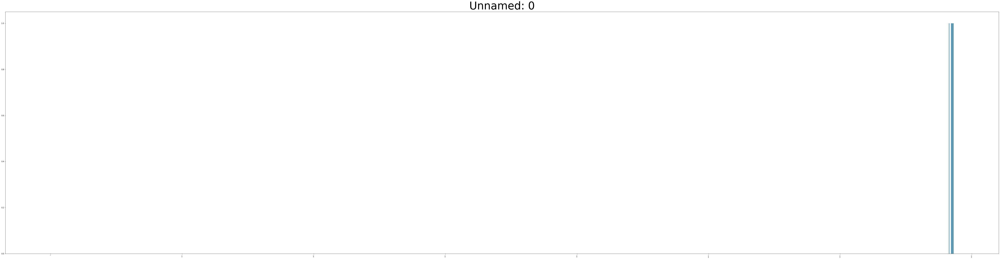

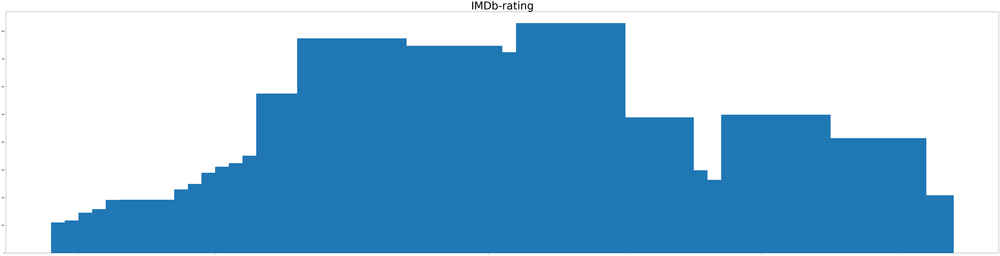

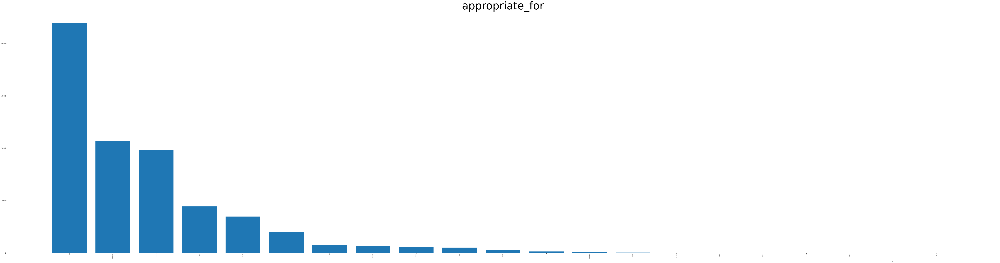

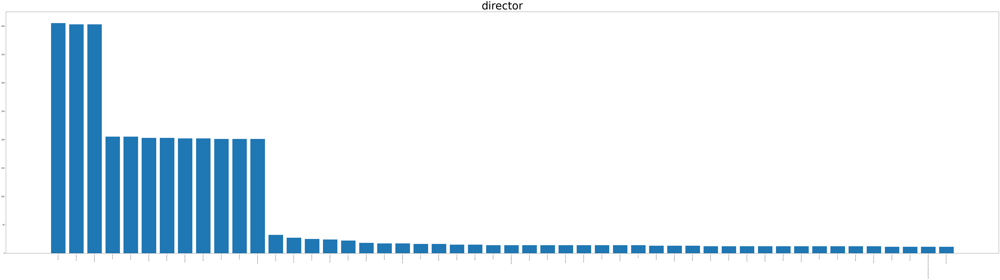

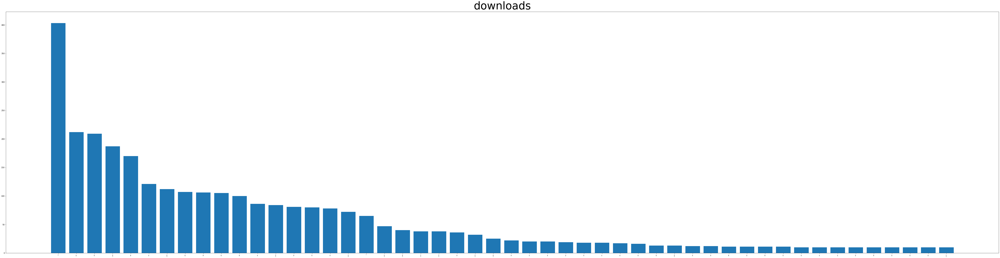

...

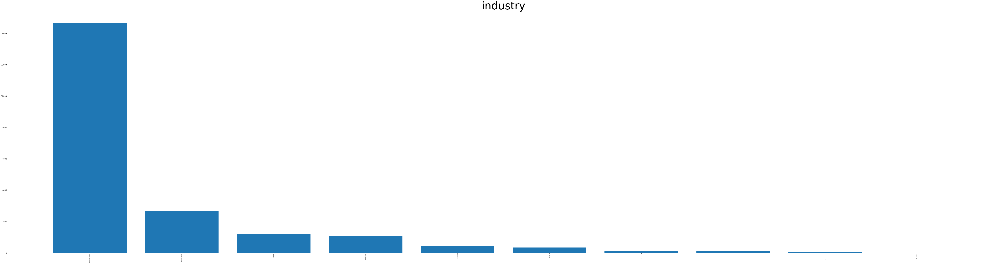

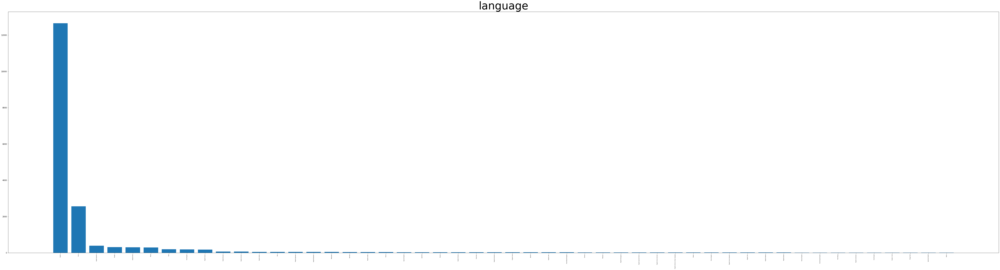

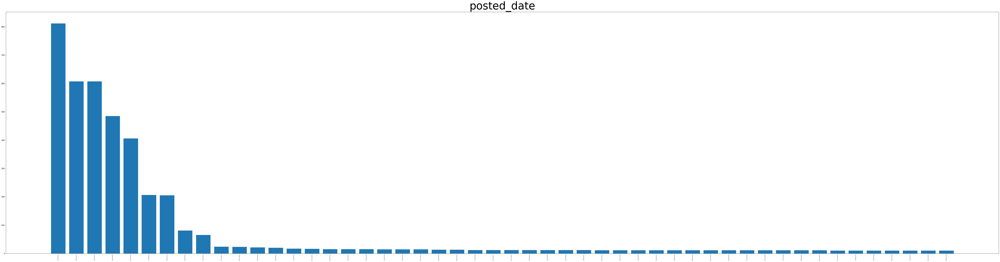

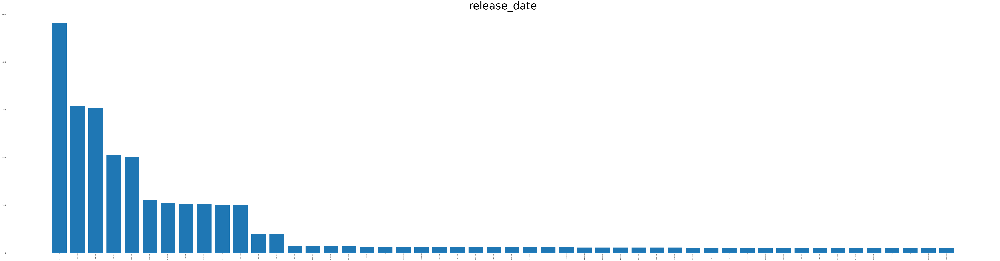

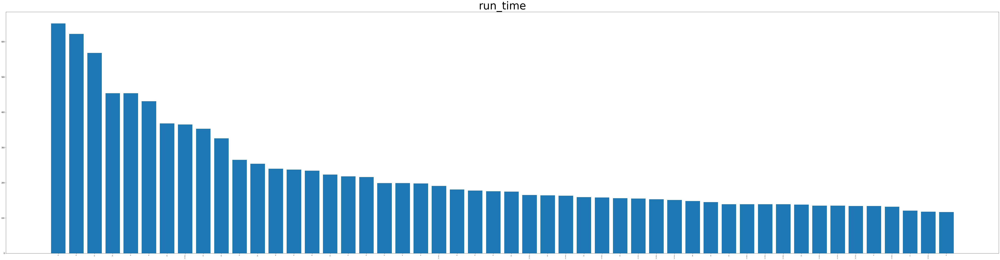

) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


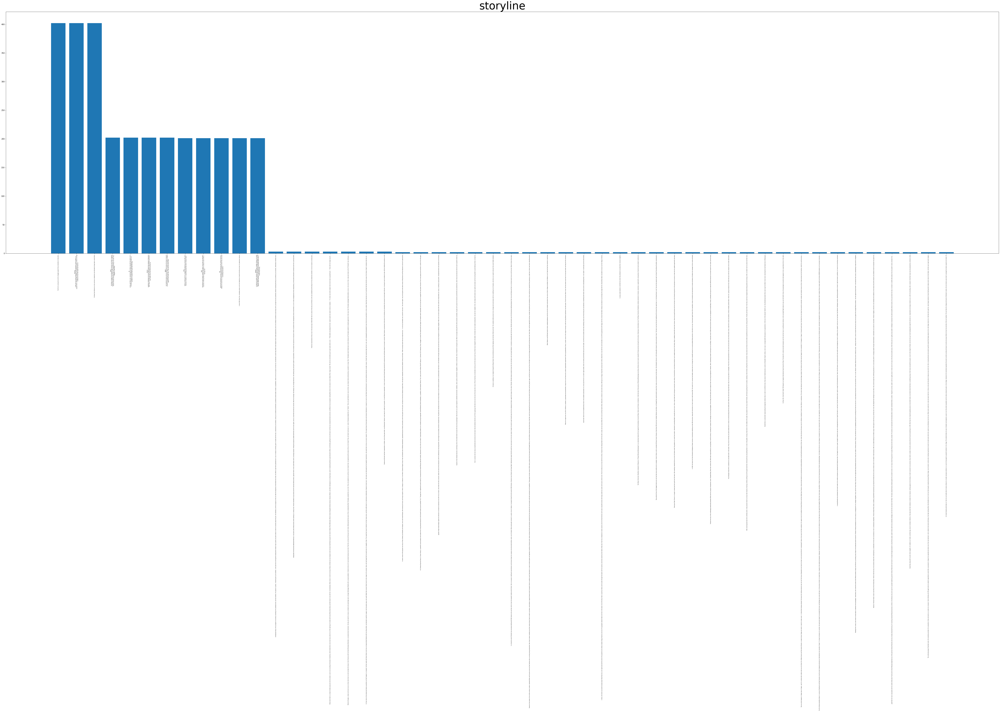

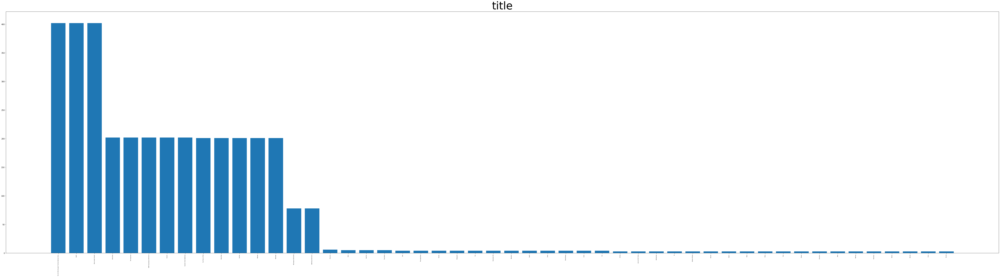

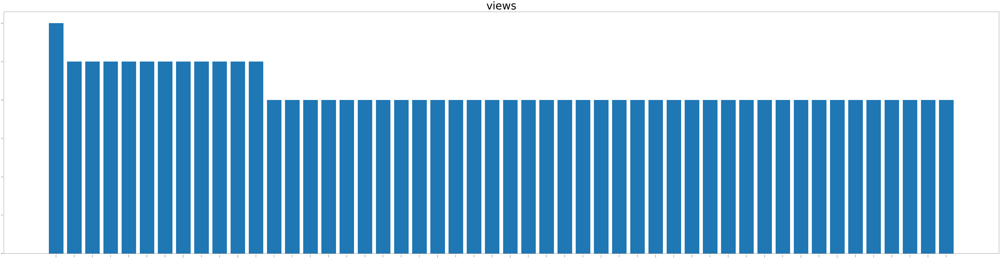

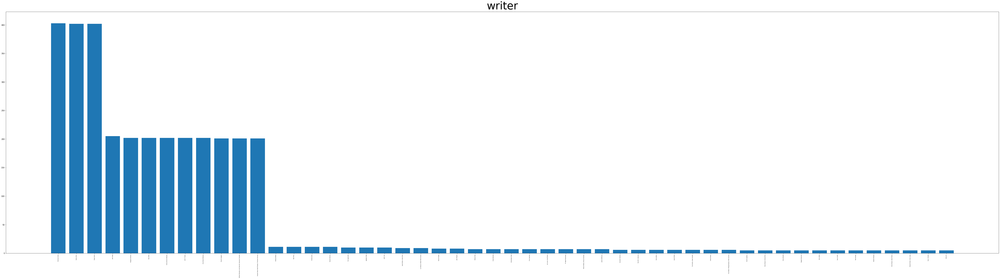

In [38]:
# 使用直方图、盒图等检查数据分布及离群点
# 绘制频数柱状图
for key in df2.columns:
    if not len(frequency[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency[key].name, fontsize=60)    
    plt.bar(frequency[key].index[:50], frequency[key].values[:50])  # 数量太多，截断显示
    plt.xticks(rotation=90, fontsize=5)
    plt.show()

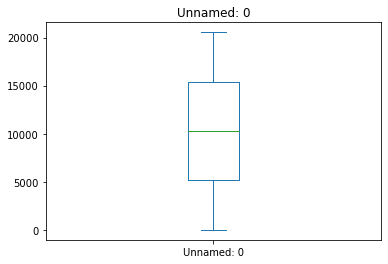

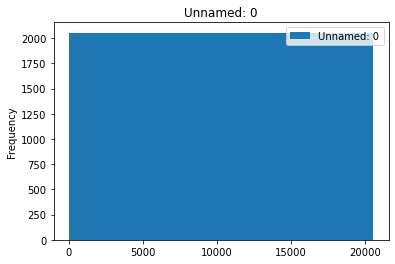

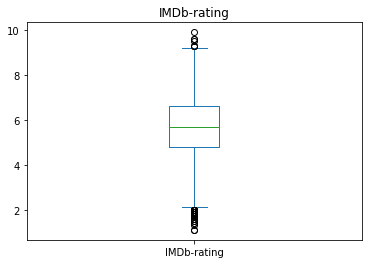

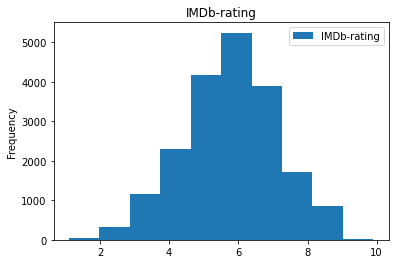

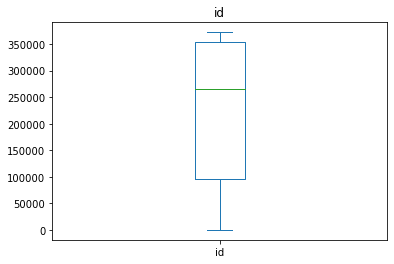

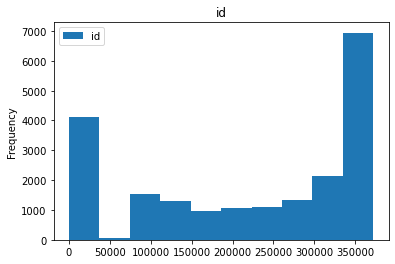

In [39]:
# 绘制数值属性直方图、盒图
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
for key in numeric_keys:
    df2[[key]].plot(kind='box', title=key)
    df2[[key]].plot(kind='hist', title=key)

### 2. 数据缺失的处理
观察数据集中缺失数据，分析其缺失的原因。分别使用下列四种策略对缺失值进行处理。注意：在处理后完成，要对比新旧数据集的差异。

In [40]:
# 所有列缺失值数量
df2.isnull().sum(axis=0)

Unnamed: 0            0
IMDb-rating         841
appropriate_for    9476
director           1938
downloads             1
id                    0
industry              1
language            542
posted_date           1
release_date          1
run_time           1768
storyline          1701
title                 1
views                 1
writer             2192
dtype: int64

#### 2.1 将缺失部分剔除

In [41]:
df2_new = df2.dropna(axis=0, inplace=False)
df2_new

,Unnamed: 0,IMDb-rating,appropriate_for,director,downloads,id,industry,language,posted_date,release_date,run_time,storyline,title,views,writer
0,0,4.8,R,John Swab,304,372092,Hollywood / English,English,"20 Feb, 2023",Jan 28 2023,105,Doc\r\n facilitates a fragile truce between th...,Little Dixie,"2,794",John Swab
1,1,6.4,TV-PG,Paul Ziller,73,372091,Hollywood / English,English,"20 Feb, 2023",Feb 05 2023,84,Caterer\r\n Goldy Berry reunites with detectiv...,Grilling Season: A Curious Caterer Mystery,"1,002",John Christian Plummer
2,2,5.2,R,Ben Wheatley,"1,427",343381,Hollywood / English,"English,Hindi","20 Apr, 2021",Jun 18 2021,1h 47min,As the world searches for a cure to a disastro...,In the Earth,"14,419",Ben Wheatley
7,7,6.5,R,Benjamin Caron,"1,781",371751,Hollywood / English,English,"13 Feb, 2023",Feb 17 2023,116,"Motivations are suspect, and expectations are ...",Sharper,"18,225","Brian Gatewood, Alessandro Tanaka"
8,8,6.9,PG-13,Ravi Kapoor,458,372042,Hollywood / English,English,"18 Feb, 2023",Dec 02 2022,80,An\r\n unmotivated South Asian American rapper...,Four Samosas,"6,912",Ravi Kapoor
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20522,20522,7.1,Not Rated,Biren Nag,"1,932",23825,Bollywood / Indian,Hindi,"01 Jan, 1970",May 11 1962,158,"After a lusty Thakur rapes a young girl, she k...",Bees Saal Baad,"6,076","Dhruva Chatterjee, Dev Kishan"
20525,20525,7.0,G,Guy Hamilton,"2,544",25548,Hollywood / English,"English,German,Polish,French","01 Jan, 1970",Sep 17 1969,132,Historical reenactment of the air war in the e...,Battle of Britain,"9,319","James Kennaway, Wilfred Greatorex, Derek Dempster"
20533,20533,5.6,R,Barbara Topsøe-Rothenborg,"12,284",1173,Hollywood / English,"Spanish,German,English","26 May, 2016",Jan 01 1970,90,"LOVE AT FIRST HICCUP is a charming, innocent, ...",Love at First Hiccup,"36,022","Barbara Topsøe-Rothenborg, Søren Frellesen, De..."
20537,20537,7.1,Not Rated,Biren Nag,"1,932",23825,Bollywood / Indian,Hindi,"01 Jan, 1970",May 11 1962,158,"After a lusty Thakur rapes a young girl, she k...",Bees Saal Baad,"6,077","Dhruva Chatterjee, Dev Kishan"


In [42]:
# 对比新旧数据集的差异
print(df2.info())
print(df2_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20548 entries, 0 to 20547
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       20548 non-null  int64  
 1   IMDb-rating      19707 non-null  float64
 2   appropriate_for  11072 non-null  object 
 3   director         18610 non-null  object 
 4   downloads        20547 non-null  object 
 5   id               20548 non-null  int64  
 6   industry         20547 non-null  object 
 7   language         20006 non-null  object 
 8   posted_date      20547 non-null  object 
 9   release_date     20547 non-null  object 
 10  run_time         18780 non-null  object 
 11  storyline        18847 non-null  object 
 12  title            20547 non-null  object 
 13  views            20547 non-null  object 
 14  writer           18356 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 2.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Int

In [43]:
# 对比5数概括及缺失值的个数
# Unnamed: 0,IMDb-rating,id
describe2 = df2.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.8,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,841.0,0.00


In [44]:
# Unnamed: 0,IMDb-rating,id
describe2 = df2_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2_new.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.100,1.00
25%,6039.25,5.200,81579.50
50%,11286.00,6.000,211770.50
75%,15726.75,6.675,340104.75
max,20540.00,9.300,372092.00
NaN count,0.00,0.000,0.00


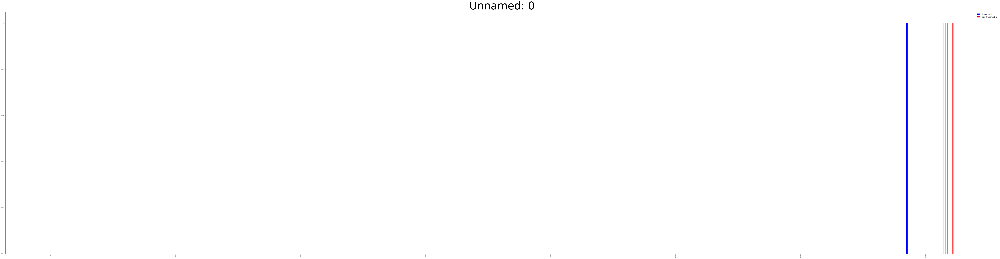

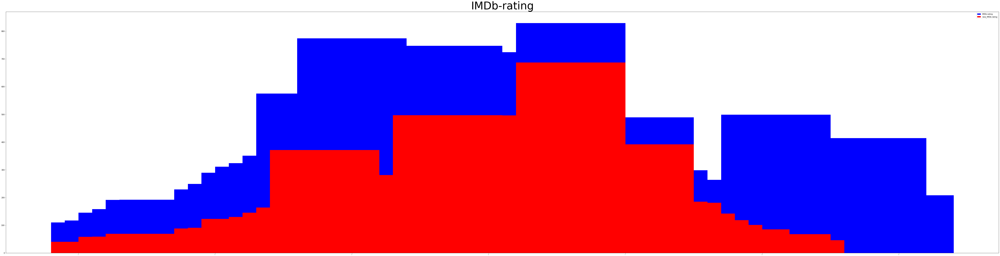

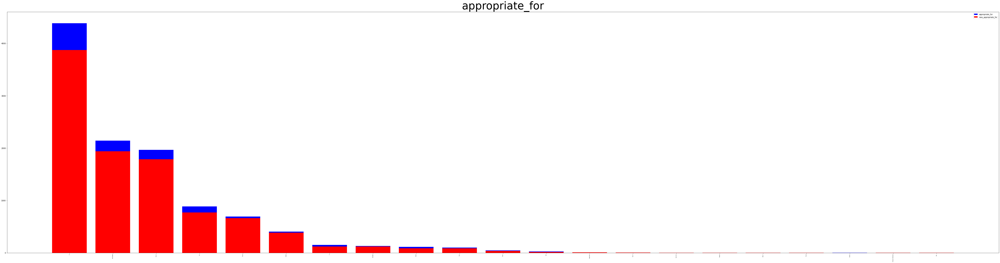

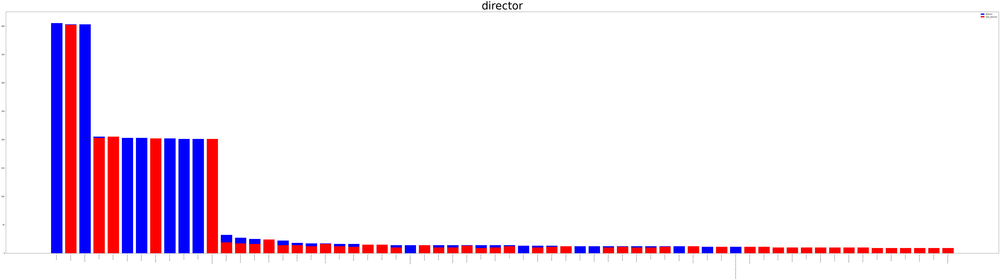

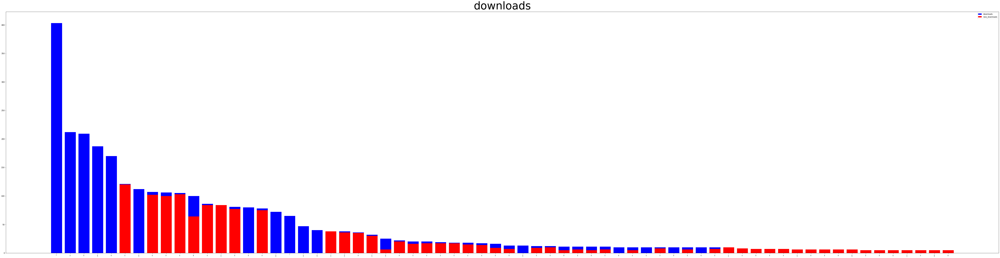

...

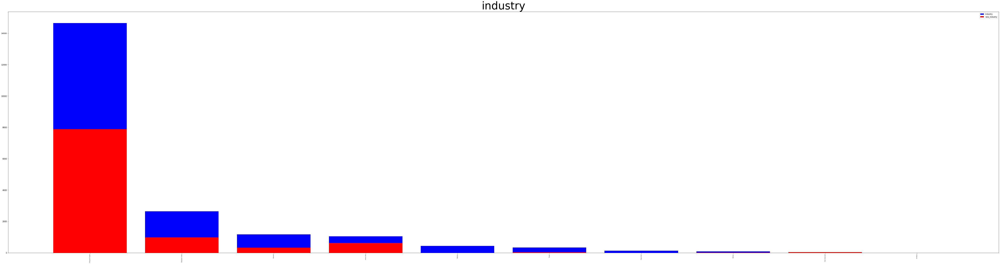

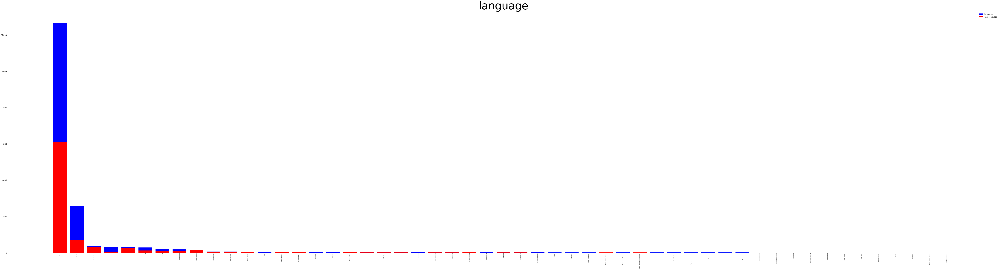

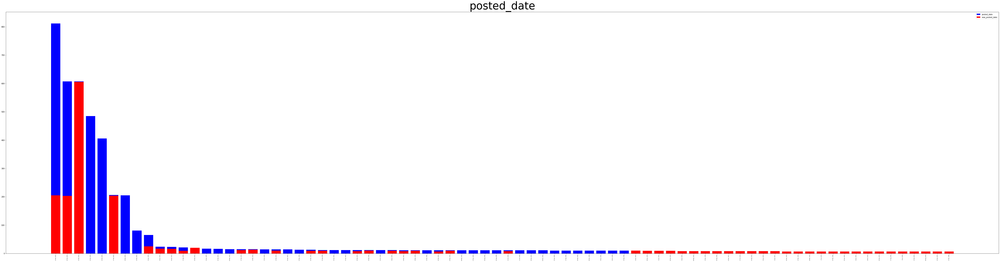

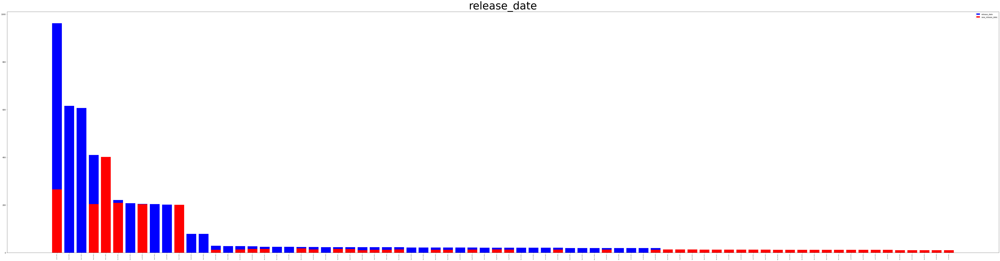

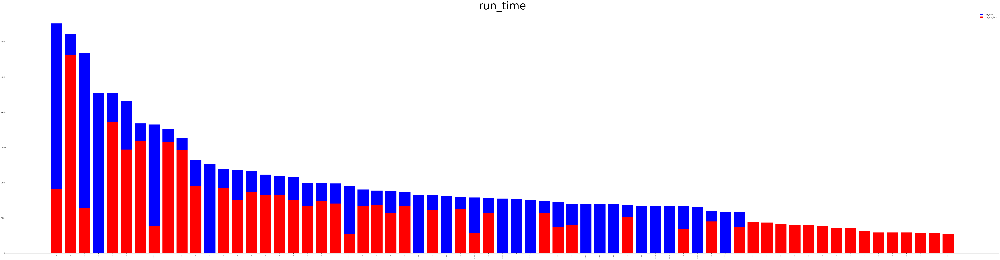

) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


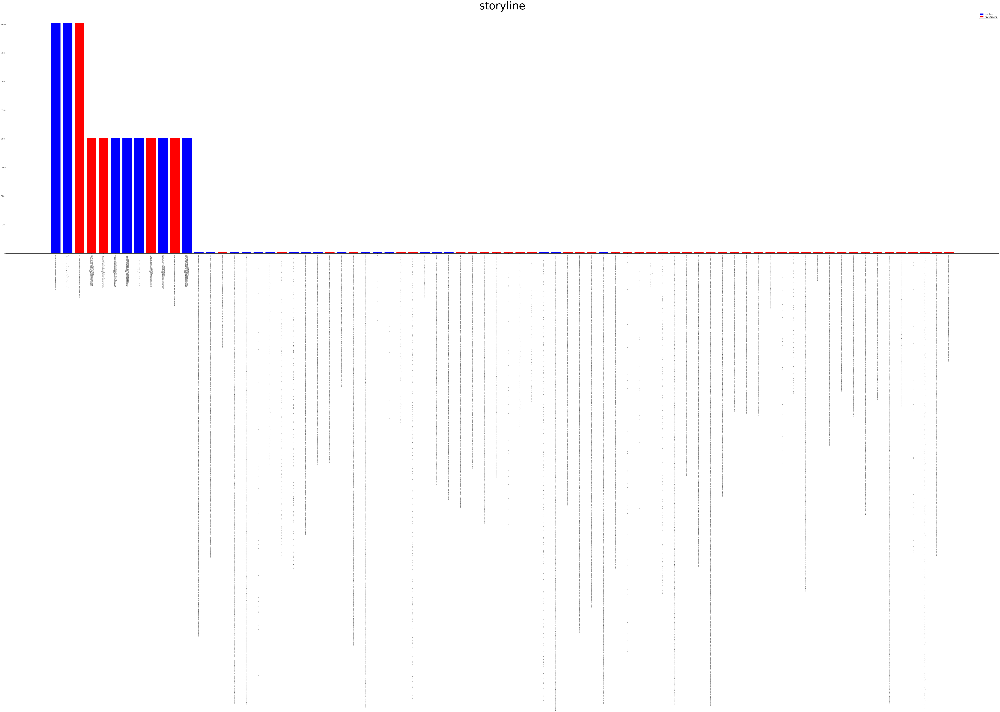

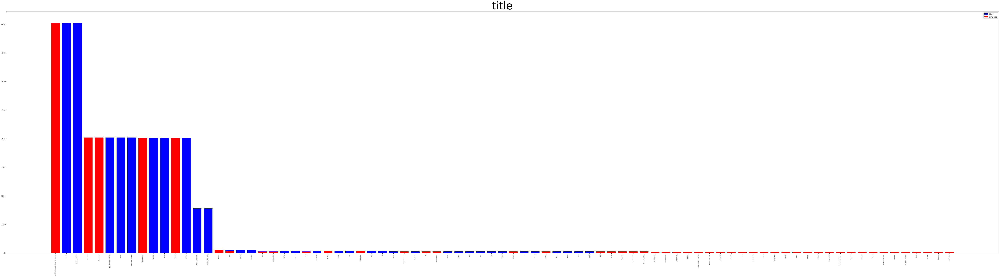

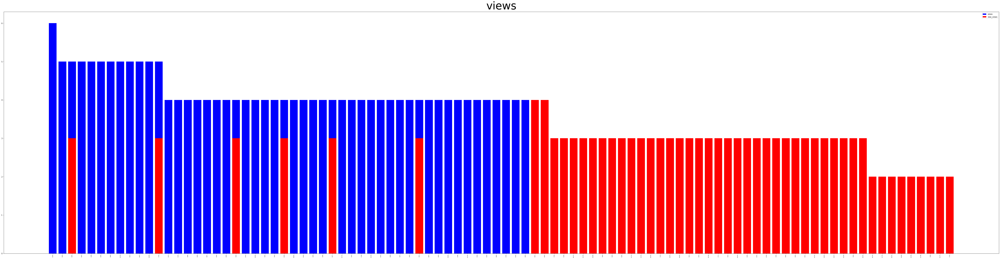

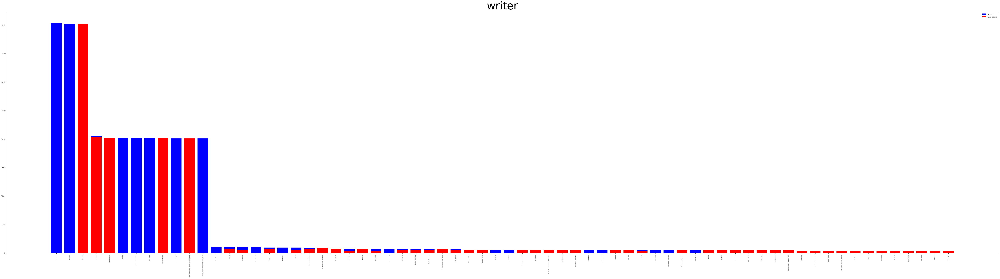

In [45]:
# 绘制频数柱状图对比
frequency_new = {key: df2_new[key].value_counts() for key in df2_new.columns}
for key in df2_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency[key].index[:50], frequency[key].values[:50],color='b',label=frequency[key].name)  # 数量太多，截断显示
    plt.bar(frequency_new[key].index[:50], frequency_new[key].values[:50],color='r',label='new_' + frequency_new[key].name)  # 数量太多，截断显示
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

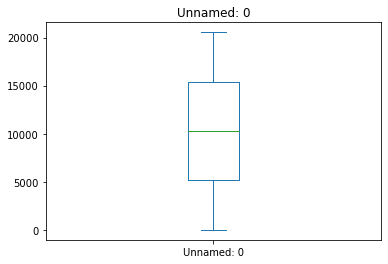

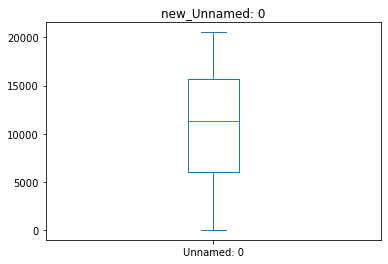

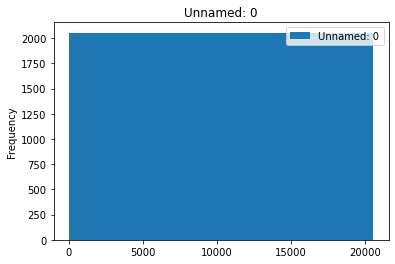

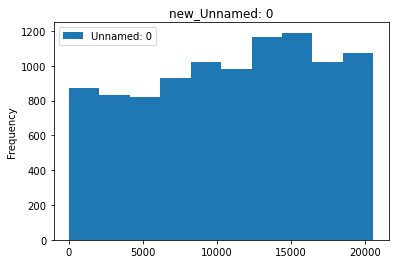

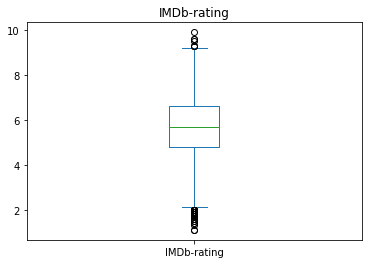

...

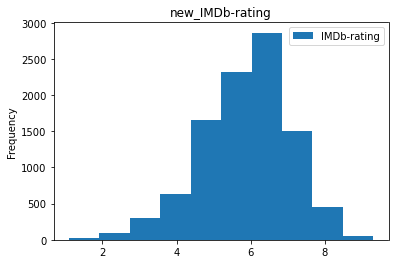

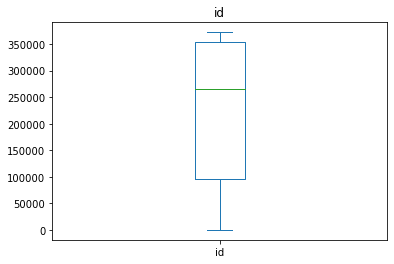

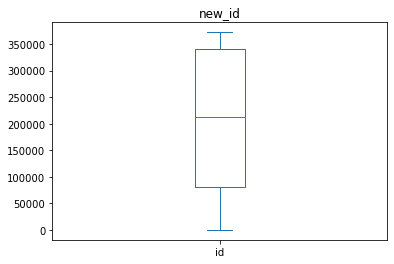

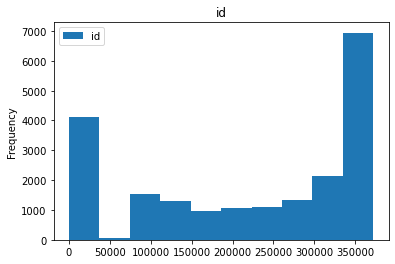

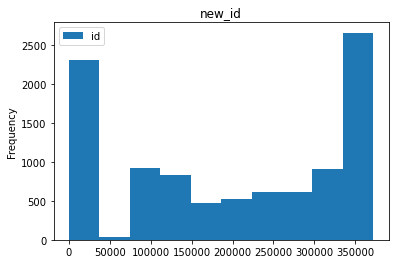

In [46]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
for key in numeric_keys:
    df2[[key]].plot(kind='box', title=key)
    df2_new[[key]].plot(kind='box', title='new_' + key)
    
    df2[[key]].plot(kind='hist', title=key)
    df2_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于将缺失部分剔除，数据条数减少了，因此数据分布发生了变化
#### 2.2 用最高频率值来填补缺失值

In [47]:
df2_new = df2.copy(deep=True)
for key in df2_new.columns:
    df2_new[key].fillna(df2_new[key].mode()[0],inplace=True)
df2_new

,Unnamed: 0,IMDb-rating,appropriate_for,director,downloads,id,industry,language,posted_date,release_date,run_time,storyline,title,views,writer
0,0,4.8,R,John Swab,304,372092,Hollywood / English,English,"20 Feb, 2023",Jan 28 2023,105,Doc\r\n facilitates a fragile truce between th...,Little Dixie,"2,794",John Swab
1,1,6.4,TV-PG,Paul Ziller,73,372091,Hollywood / English,English,"20 Feb, 2023",Feb 05 2023,84,Caterer\r\n Goldy Berry reunites with detectiv...,Grilling Season: A Curious Caterer Mystery,"1,002",John Christian Plummer
2,2,5.2,R,Ben Wheatley,"1,427",343381,Hollywood / English,"English,Hindi","20 Apr, 2021",Jun 18 2021,1h 47min,As the world searches for a cure to a disastro...,In the Earth,"14,419",Ben Wheatley
3,3,8.1,R,Venky Atluri,"1,549",372090,Tollywood,Hindi,"20 Feb, 2023",Feb 17 2023,139,The life of a young man and his struggles agai...,Vaathi,"4,878",Venky Atluri
4,4,4.6,R,Shaji Kailas,657,372089,Tollywood,Hindi,"20 Feb, 2023",Jan 26 2023,122,A man named Kalidas gets stranded due to the p...,Alone,"2,438",Rajesh Jayaraman
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20543,20543,6.6,R,Venky Atluri,"1,998",28957,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 13 1959,93,Follows\r\n a New York City family hiding out ...,Bhai-Bahen,"6,219",Nicholas Schutt
20544,20544,7.7,R,Bimal Roy,"6,080",28958,Bollywood / Indian,Hindi,"01 Jan, 1970",May 13 1955,159,Devdas and Parvati had been inseparable as chi...,Devdas,"16,376","Rajinder Singh Bedi, Saratchandra Chatterjee, ..."
20545,20545,8.0,R,Venky Atluri,"3,276",30459,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 28 1958,1h 50min,"While driving his car on a rainy night, Anand'...",Madhumati,"7,220",Nicholas Schutt
20546,20546,6.6,R,Venky Atluri,309,371669,Wrestling,English,"10 Feb, 2023",Feb 09 2023,93,Follows\r\n a New York City family hiding out ...,TNA.Impact 2023-02-09,"1,419",Nicholas Schutt


In [48]:
# 对比新旧数据集的差异
print(df2.info())
print(df2_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20548 entries, 0 to 20547
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       20548 non-null  int64  
 1   IMDb-rating      19707 non-null  float64
 2   appropriate_for  11072 non-null  object 
 3   director         18610 non-null  object 
 4   downloads        20547 non-null  object 
 5   id               20548 non-null  int64  
 6   industry         20547 non-null  object 
 7   language         20006 non-null  object 
 8   posted_date      20547 non-null  object 
 9   release_date     20547 non-null  object 
 10  run_time         18780 non-null  object 
 11  storyline        18847 non-null  object 
 12  title            20547 non-null  object 
 13  views            20547 non-null  object 
 14  writer           18356 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 2.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Ran

In [49]:
# 对比5数概括及缺失值的个数
# Unnamed: 0,IMDb-rating,id
describe2 = df2.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.8,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,841.0,0.00


In [50]:
# Unnamed: 0,IMDb-rating,id
describe2 = df2_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2_new.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.9,96122.25
50%,10273.50,5.8,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,0.0,0.00


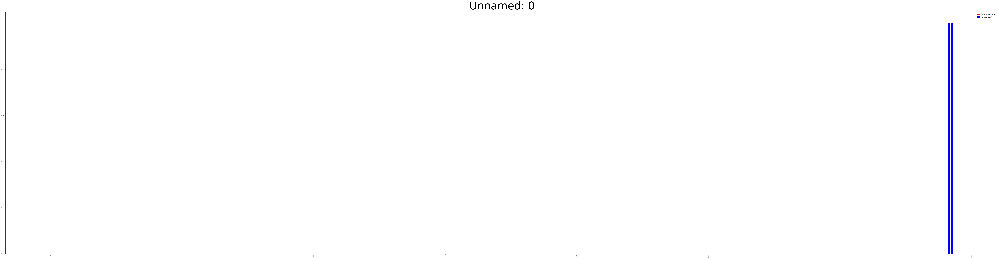

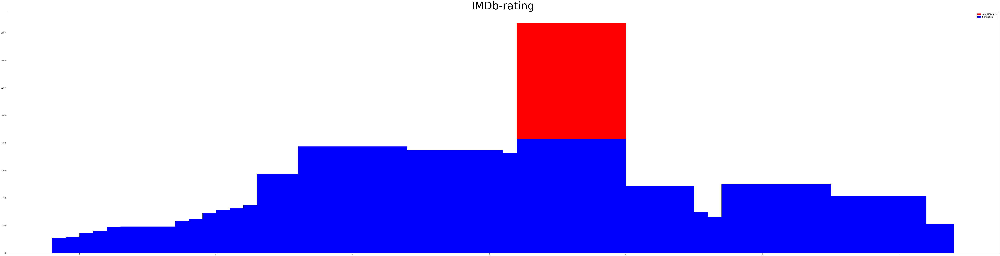

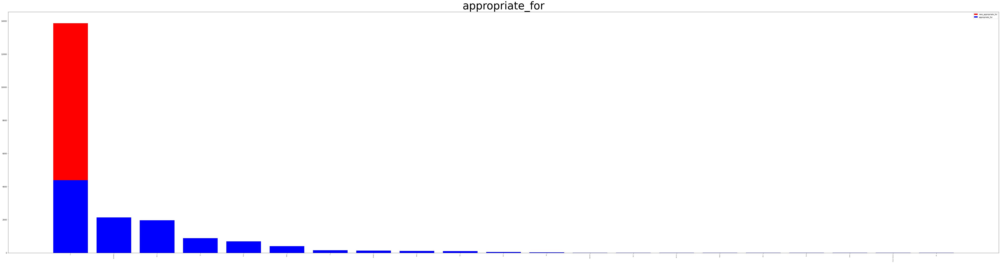

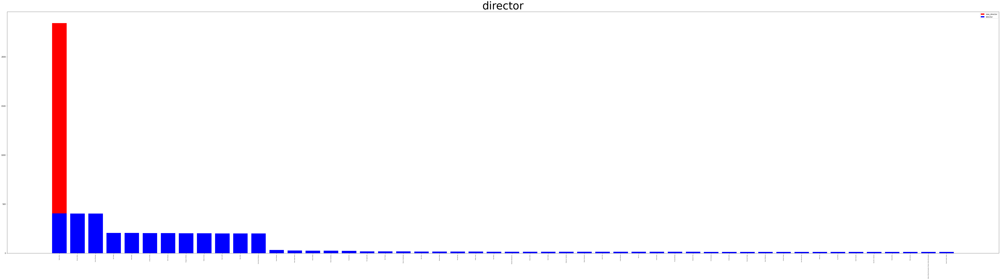

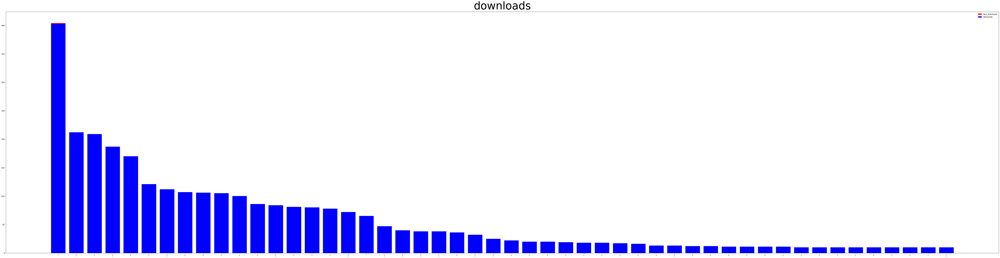

...

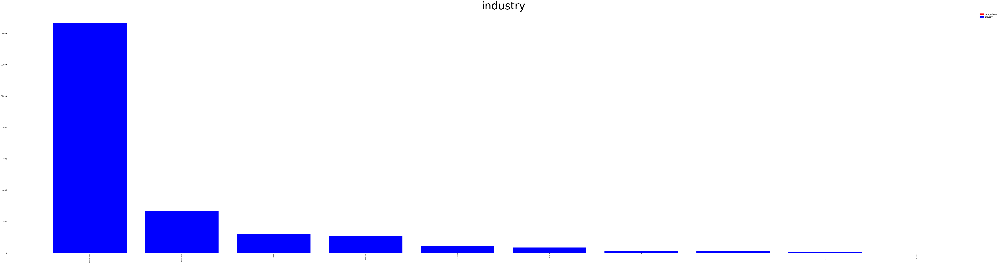

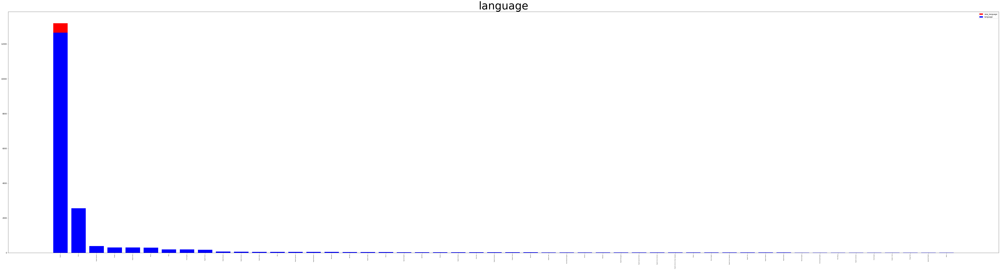

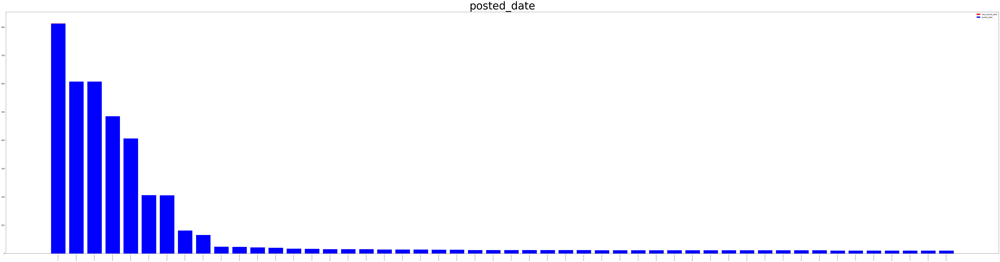

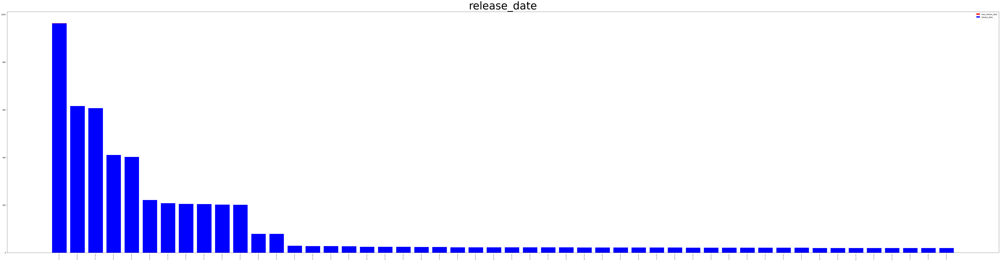

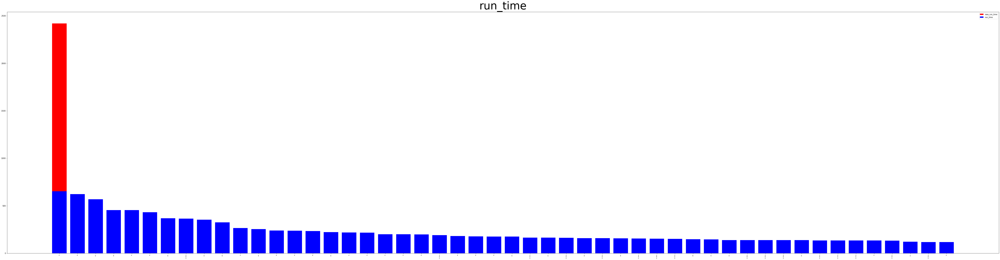

) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


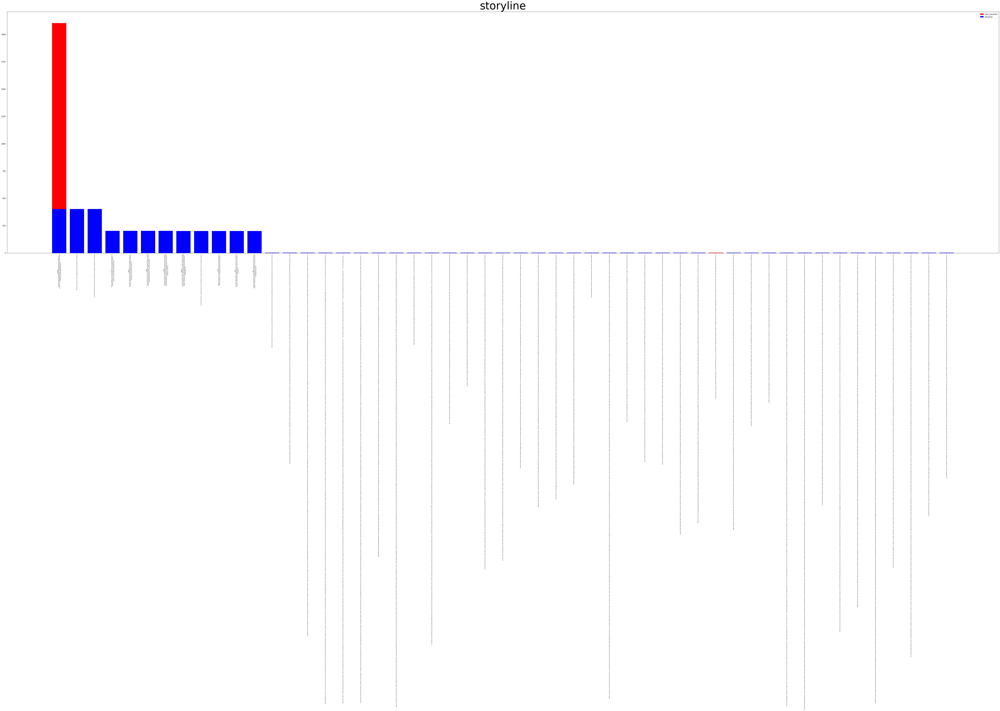

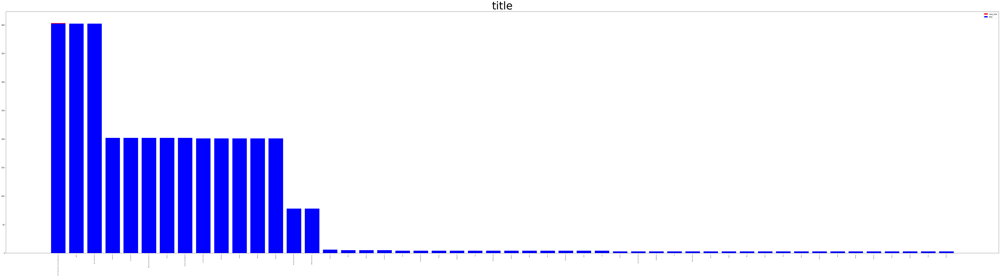

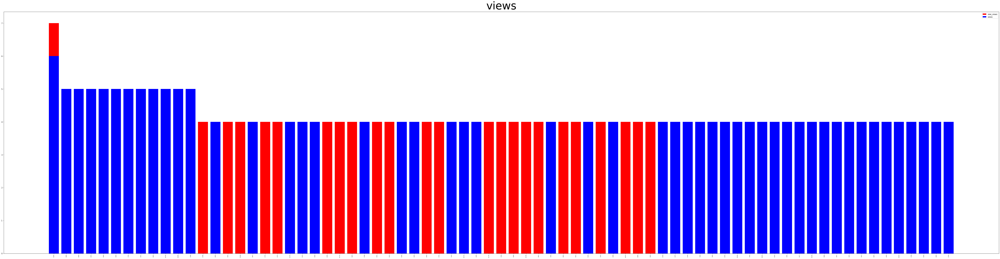

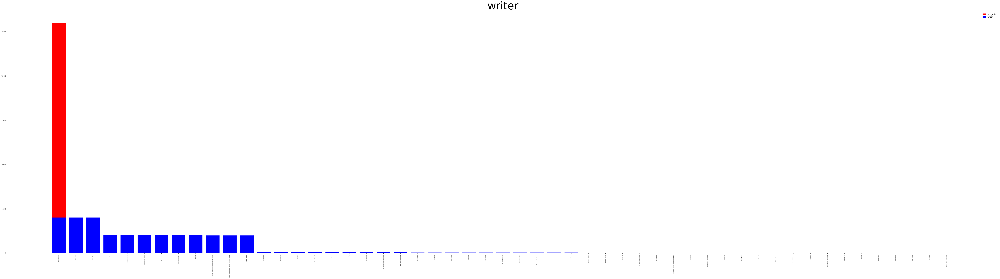

In [51]:
# 绘制频数柱状图对比
frequency_new = {key: df2_new[key].value_counts() for key in df2_new.columns}
for key in df2_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index[:50], frequency_new[key].values[:50],color='r',label='new_' + frequency_new[key].name)  # 数量太多，截断显示
    plt.bar(frequency[key].index[:50], frequency[key].values[:50],color='b',label=frequency[key].name)  # 数量太多，截断显示
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

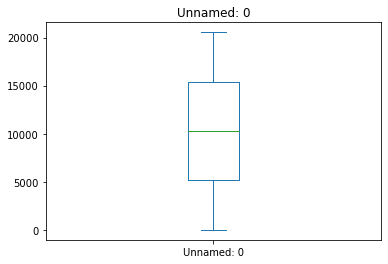

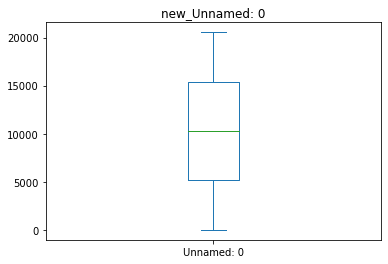

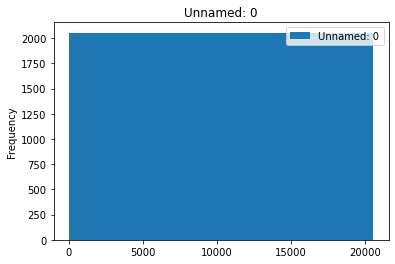

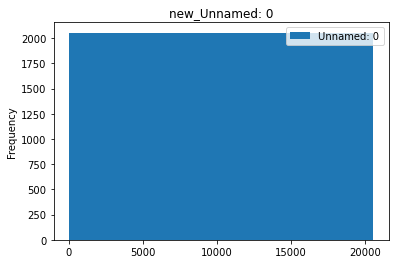

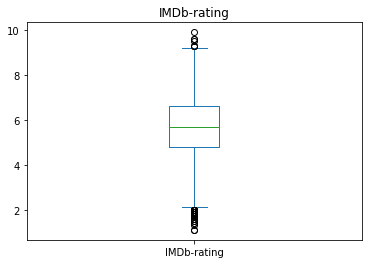

...

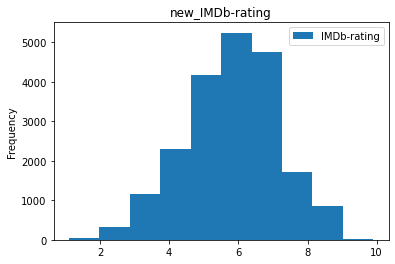

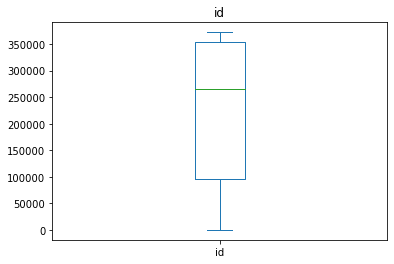

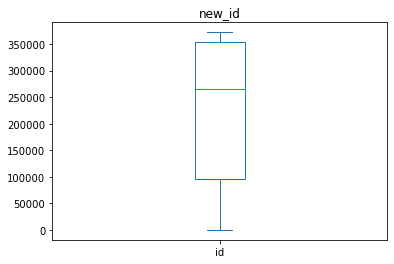

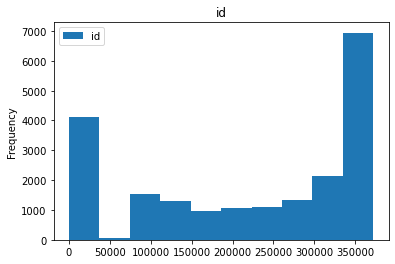

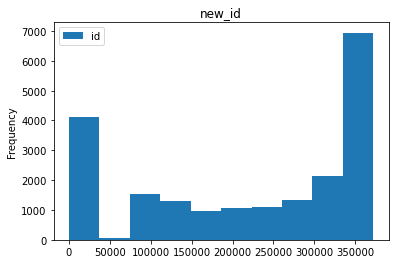

In [52]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
for key in numeric_keys:
    df2[[key]].plot(kind='box', title=key)
    df2_new[[key]].plot(kind='box', title='new_' + key)
    
    df2[[key]].plot(kind='hist', title=key)
    df2_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于用最高频率值来填补缺失值，频数高的数据数量增多，因此数据分布发生了变化
#### 2.3 通过属性的相关关系来填补缺失值

In [53]:
miss_columns = ['IMDb-rating', 'appropriate_for', 'downloads', 'industry', 'language', 'posted_date', 'release_date', 'run_time', 
                'storyline', 'title', 'views', 'writer']
comp_columns = ['Unnamed: 0', 'id']
df2_new = df2.copy(deep=True)
for miss_column in miss_columns:
    comp_columns.insert(0, miss_column)
    
    enc_label = OrdinalEncoder()
    enc_fea = OrdinalEncoder()
    miss_index = comp_columns[0]
    
    # 选择数值属性用来计算随机森林
    train_df = df2_new[comp_columns]
    known_values = np.array(train_df[train_df[miss_index].notnull()])
    unknow_values = np.array(train_df[train_df[miss_index].isnull()])
    
    # Y是缺失值
    y = known_values[:, 0].reshape(-1, 1)
    enc_label.fit(y)
    y = enc_label.transform(y)
    
    # X是特征值
    X = known_values[:, 1:]
    test_X = unknow_values[:, 1:]
    all_X = np.row_stack((X,test_X))
    enc_fea.fit(all_X)
    X = enc_fea.transform(X)
    
    # 拟合
    rfr = RandomForestRegressor(n_estimators=10)
    rfr.fit(X, y.ravel())
    # 预测
    predicted_values = rfr.predict(enc_fea.transform(unknow_values[:, 1:]))
    predicted_values = enc_label.inverse_transform(predicted_values.reshape(-1, 1))
    # 填充预测值
    df2_new.loc[(df2_new[miss_index].isnull()), miss_index] = predicted_values
df2_new

,Unnamed: 0,IMDb-rating,appropriate_for,director,downloads,id,industry,language,posted_date,release_date,run_time,storyline,title,views,writer
0,0,4.8,R,John Swab,304,372092,Hollywood / English,English,"20 Feb, 2023",Jan 28 2023,105,Doc\r\n facilitates a fragile truce between th...,Little Dixie,"2,794",John Swab
1,1,6.4,TV-PG,Paul Ziller,73,372091,Hollywood / English,English,"20 Feb, 2023",Feb 05 2023,84,Caterer\r\n Goldy Berry reunites with detectiv...,Grilling Season: A Curious Caterer Mystery,"1,002",John Christian Plummer
2,2,5.2,R,Ben Wheatley,"1,427",343381,Hollywood / English,"English,Hindi","20 Apr, 2021",Jun 18 2021,1h 47min,As the world searches for a cure to a disastro...,In the Earth,"14,419",Ben Wheatley
3,3,8.1,TV-MA,Venky Atluri,"1,549",372090,Tollywood,Hindi,"20 Feb, 2023",Feb 17 2023,139,The life of a young man and his struggles agai...,Vaathi,"4,878",Venky Atluri
4,4,4.6,TV-MA,Shaji Kailas,657,372089,Tollywood,Hindi,"20 Feb, 2023",Jan 26 2023,122,A man named Kalidas gets stranded due to the p...,Alone,"2,438",Rajesh Jayaraman
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20543,20543,7.5,Not Rated,NaN,"1,998",28957,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 13 1959,207,"In Depression-era London, a now-grown Jane and...",Bhai-Bahen,"6,219","Christina Moore, Gloria Musca"
20544,20544,7.7,Not Rated,Bimal Roy,"6,080",28958,Bollywood / Indian,Hindi,"01 Jan, 1970",May 13 1955,159,Devdas and Parvati had been inseparable as chi...,Devdas,"16,376","Rajinder Singh Bedi, Saratchandra Chatterjee, ..."
20545,20545,8.0,Not Rated,NaN,"3,276",30459,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 28 1958,1h 50min,"While driving his car on a rainy night, Anand'...",Madhumati,"7,220",Christopher MacBride
20546,20546,5.5,TV-G,NaN,309,371669,Wrestling,English,"10 Feb, 2023",Feb 09 2023,84,Jay and Silent Bob return to Hollywood to stop...,TNA.Impact 2023-02-09,"1,419",Kogonada


In [54]:
# 对比新旧数据集的差异
print(df2.info())
print(df2_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20548 entries, 0 to 20547
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       20548 non-null  int64  
 1   IMDb-rating      19707 non-null  float64
 2   appropriate_for  11072 non-null  object 
 3   director         18610 non-null  object 
 4   downloads        20547 non-null  object 
 5   id               20548 non-null  int64  
 6   industry         20547 non-null  object 
 7   language         20006 non-null  object 
 8   posted_date      20547 non-null  object 
 9   release_date     20547 non-null  object 
 10  run_time         18780 non-null  object 
 11  storyline        18847 non-null  object 
 12  title            20547 non-null  object 
 13  views            20547 non-null  object 
 14  writer           18356 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 2.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Ran

In [55]:
# 对比5数概括及缺失值的个数
# Unnamed: 0,IMDb-rating,id
describe2 = df2.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.8,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,841.0,0.00


In [56]:
# Unnamed: 0,IMDb-rating,id
describe2 = df2_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2_new.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.9,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,0.0,0.00


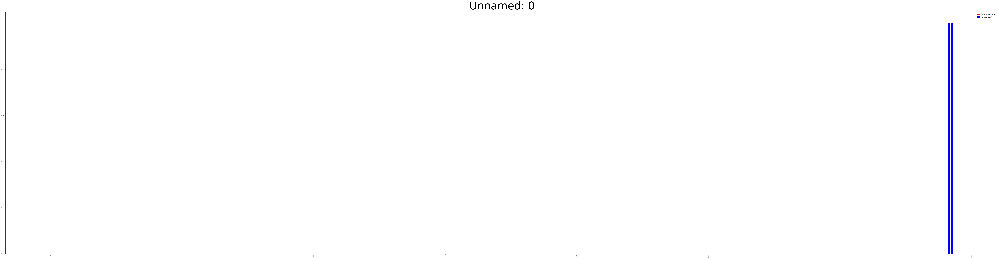

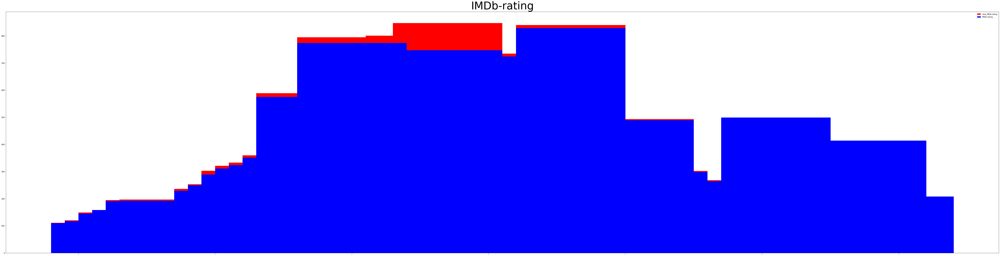

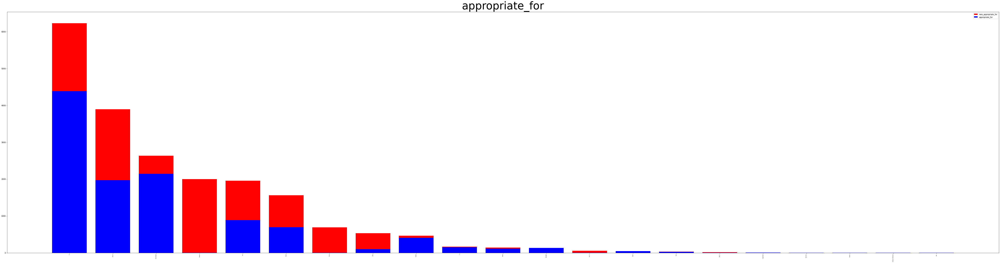

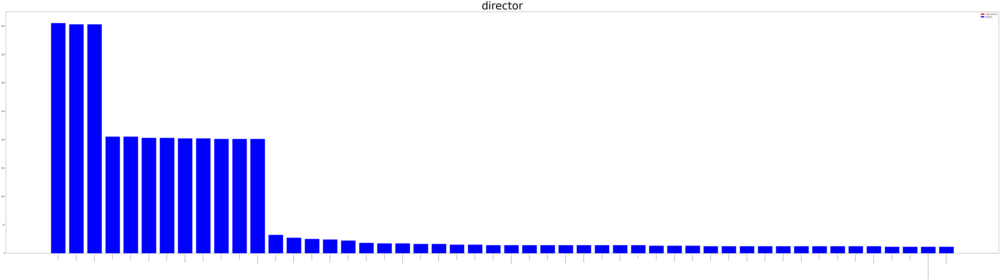

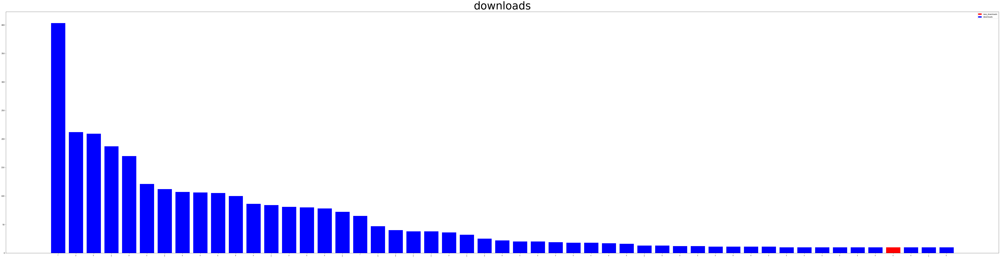

...

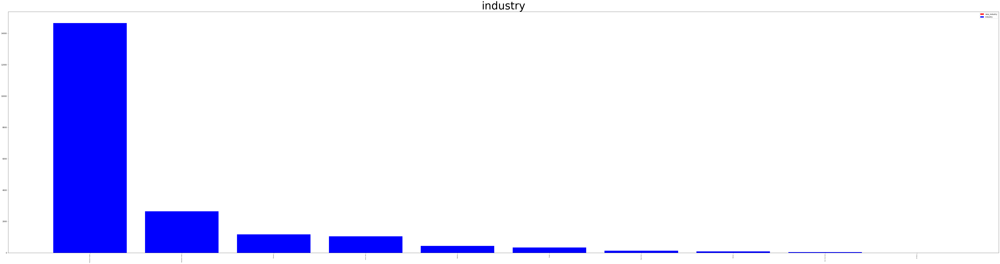

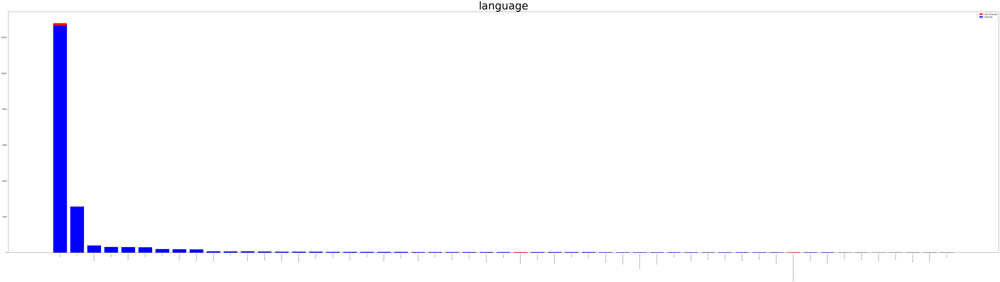

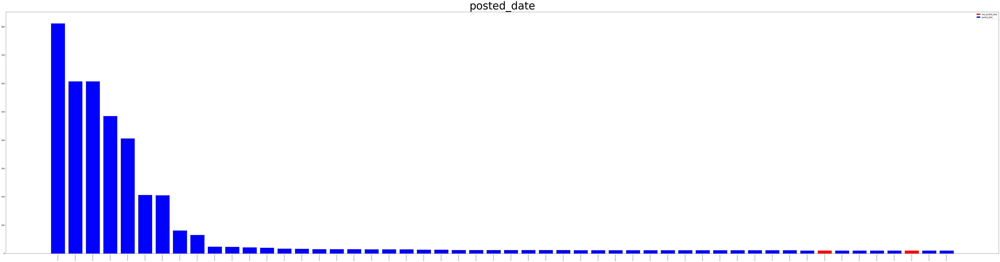

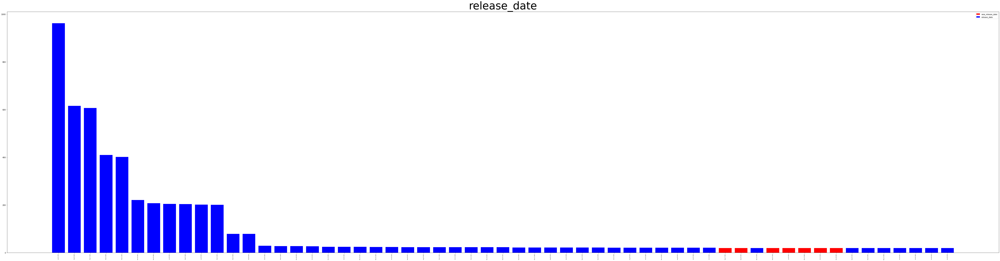

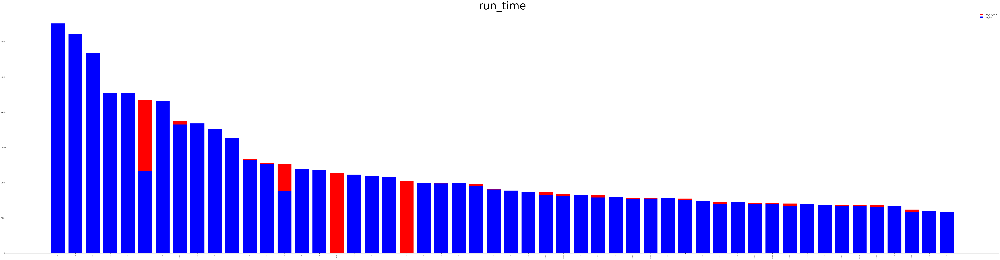

) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


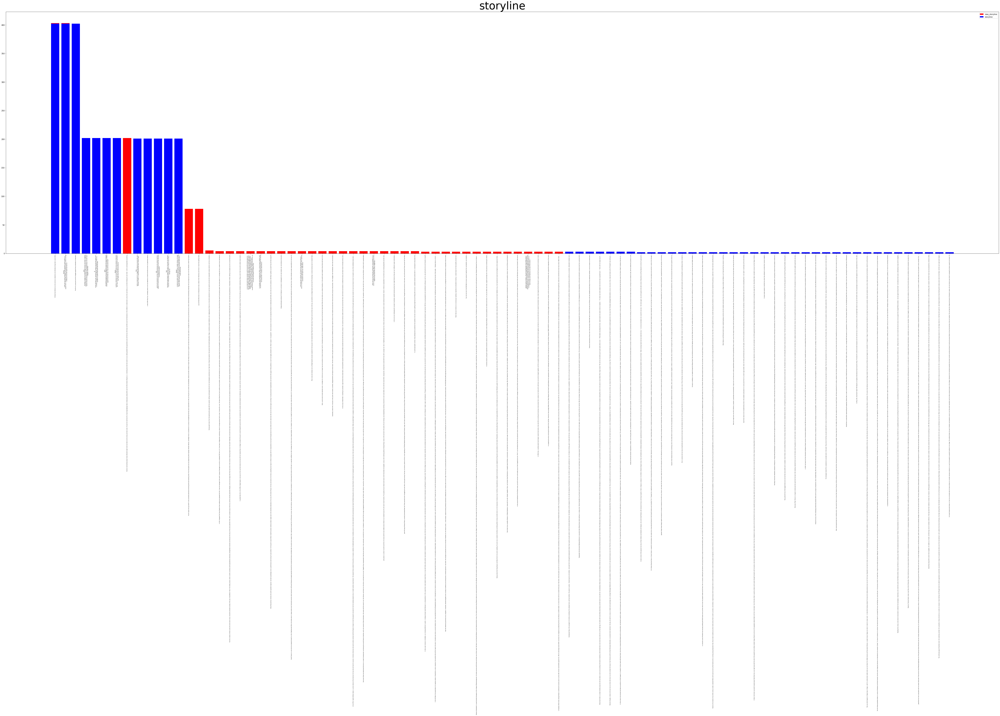

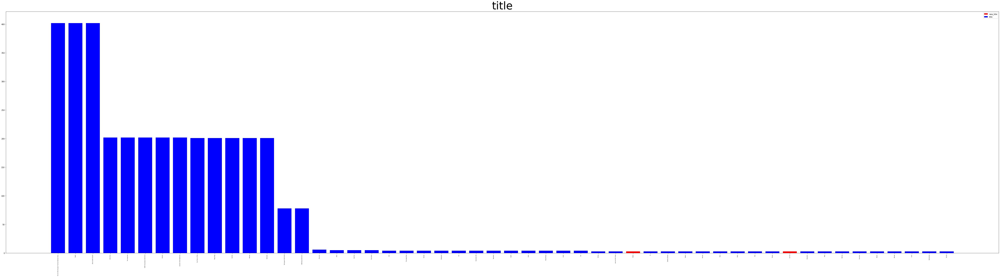

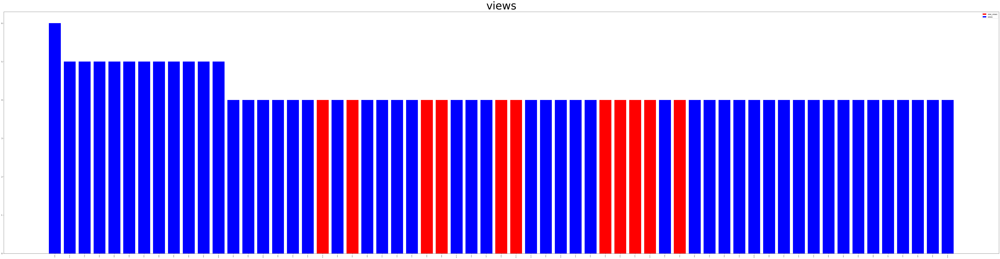

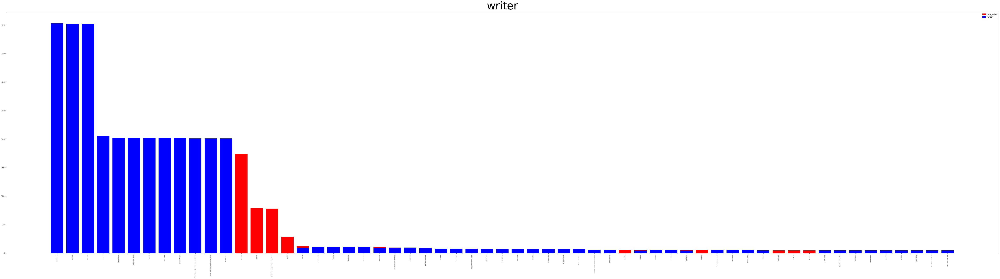

In [57]:
# 绘制频数柱状图对比
frequency_new = {key: df2_new[key].value_counts() for key in df2_new.columns}
for key in df2_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index[:50], frequency_new[key].values[:50],color='r',label='new_' + frequency_new[key].name)  # 数量太多，截断显示
    plt.bar(frequency[key].index[:50], frequency[key].values[:50],color='b',label=frequency[key].name)  # 数量太多，截断显示
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

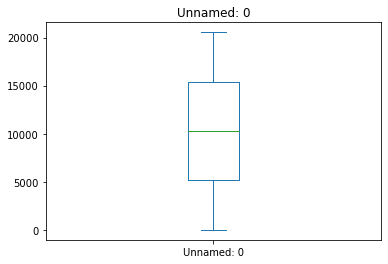

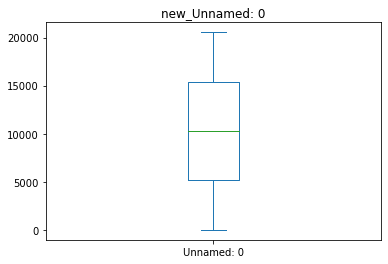

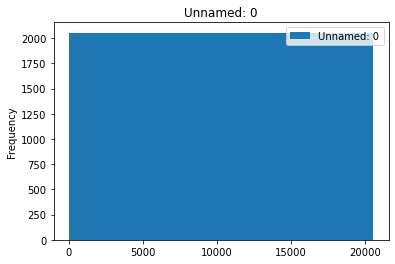

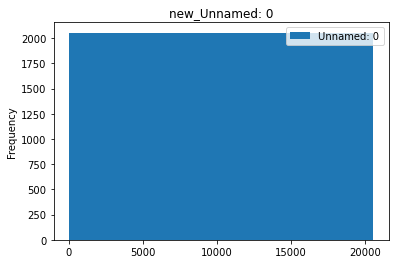

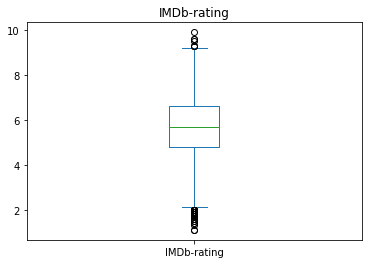

...

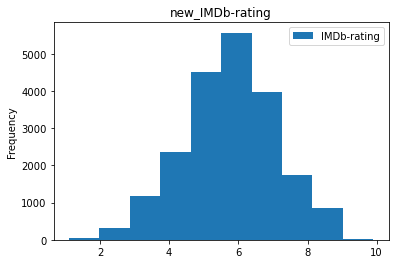

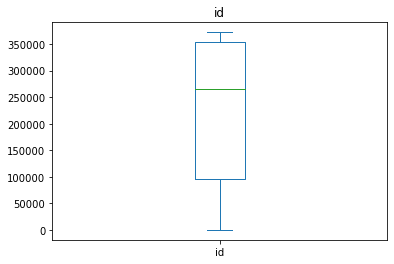

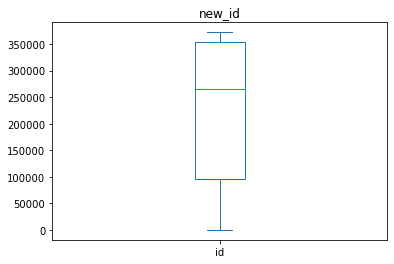

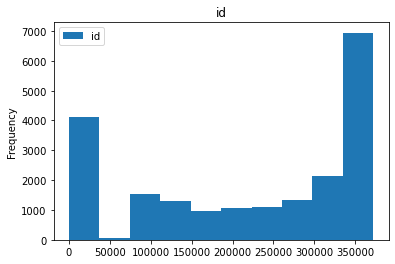

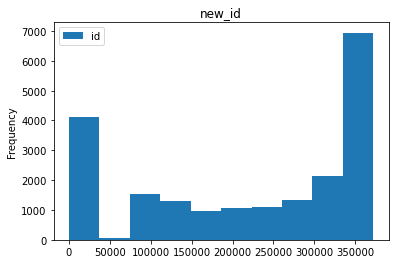

In [58]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
for key in numeric_keys:
    df2[[key]].plot(kind='box', title=key)
    df2_new[[key]].plot(kind='box', title='new_' + key)
    
    df2[[key]].plot(kind='hist', title=key)
    df2_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于通过属性的相关关系来填补缺失值，相关性高的数据频数增多，因此数据分布发生了变化
#### 2.4 通过数据对象之间的相似性来填补缺失值

In [59]:
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
sys.setrecursionlimit(10000)
df2_new = df2.copy(deep=True)
imputed_training=fast_knn(df2_new[numeric_keys].values, k=10)
imputed_training=pd.DataFrame(data=imputed_training,columns=numeric_keys)
df2_new[numeric_keys] = imputed_training[numeric_keys]
df2_new

,Unnamed: 0,IMDb-rating,appropriate_for,director,downloads,id,industry,language,posted_date,release_date,run_time,storyline,title,views,writer
0,0.0,4.800000,R,John Swab,304,372092.0,Hollywood / English,English,"20 Feb, 2023",Jan 28 2023,105,Doc\r\n facilitates a fragile truce between th...,Little Dixie,"2,794",John Swab
1,1.0,6.400000,TV-PG,Paul Ziller,73,372091.0,Hollywood / English,English,"20 Feb, 2023",Feb 05 2023,84,Caterer\r\n Goldy Berry reunites with detectiv...,Grilling Season: A Curious Caterer Mystery,"1,002",John Christian Plummer
2,2.0,5.200000,R,Ben Wheatley,"1,427",343381.0,Hollywood / English,"English,Hindi","20 Apr, 2021",Jun 18 2021,1h 47min,As the world searches for a cure to a disastro...,In the Earth,"14,419",Ben Wheatley
3,3.0,8.100000,NaN,Venky Atluri,"1,549",372090.0,Tollywood,Hindi,"20 Feb, 2023",Feb 17 2023,139,The life of a young man and his struggles agai...,Vaathi,"4,878",Venky Atluri
4,4.0,4.600000,NaN,Shaji Kailas,657,372089.0,Tollywood,Hindi,"20 Feb, 2023",Jan 26 2023,122,A man named Kalidas gets stranded due to the p...,Alone,"2,438",Rajesh Jayaraman
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20543,20543.0,6.065399,NaN,NaN,"1,998",28957.0,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 13 1959,NaN,NaN,Bhai-Bahen,"6,219",NaN
20544,20544.0,7.700000,NaN,Bimal Roy,"6,080",28958.0,Bollywood / Indian,Hindi,"01 Jan, 1970",May 13 1955,159,Devdas and Parvati had been inseparable as chi...,Devdas,"16,376","Rajinder Singh Bedi, Saratchandra Chatterjee, ..."
20545,20545.0,8.000000,NaN,NaN,"3,276",30459.0,Bollywood / Indian,Hindi,"01 Jan, 1970",Mar 28 1958,1h 50min,"While driving his car on a rainy night, Anand'...",Madhumati,"7,220",NaN
20546,20546.0,5.762151,NaN,NaN,309,371669.0,Wrestling,English,"10 Feb, 2023",Feb 09 2023,NaN,NaN,TNA.Impact 2023-02-09,"1,419",NaN


In [60]:
# 对比新旧数据集的差异
print(df2.info())
print(df2_new.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20548 entries, 0 to 20547
Data columns (total 15 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Unnamed: 0       20548 non-null  int64  
 1   IMDb-rating      19707 non-null  float64
 2   appropriate_for  11072 non-null  object 
 3   director         18610 non-null  object 
 4   downloads        20547 non-null  object 
 5   id               20548 non-null  int64  
 6   industry         20547 non-null  object 
 7   language         20006 non-null  object 
 8   posted_date      20547 non-null  object 
 9   release_date     20547 non-null  object 
 10  run_time         18780 non-null  object 
 11  storyline        18847 non-null  object 
 12  title            20547 non-null  object 
 13  views            20547 non-null  object 
 14  writer           18356 non-null  object 
dtypes: float64(1), int64(2), object(12)
memory usage: 2.4+ MB
None
<class 'pandas.core.frame.DataFrame'>
Ran

In [61]:
# 对比5数概括及缺失值的个数
# Unnamed: 0,IMDb-rating,id
describe2 = df2.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.8,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,841.0,0.00


In [62]:
# Unnamed: 0,IMDb-rating,id
describe2 = df2_new.describe().drop('mean').drop('std')  # 样本概括，5数概括包括min, 25%, 50%, 75%, max，去除不需要的值
describe2.loc['NaN count'] = df2_new.shape[0]  - describe2.loc['count'].values
describe2.drop('count')  # 5数概括及缺失值的个数，去除不需要的值

,Unnamed: 0,IMDb-rating,id
min,0.00,1.1,1.00
25%,5136.75,4.9,96122.25
50%,10273.50,5.7,264457.50
75%,15410.25,6.6,354561.25
max,20547.00,9.9,372092.00
NaN count,0.00,0.0,0.00


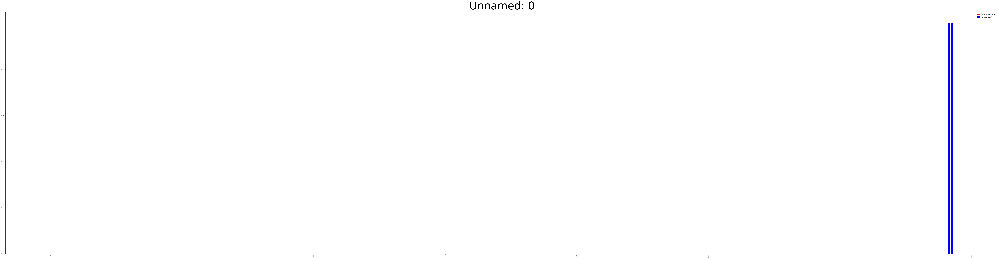

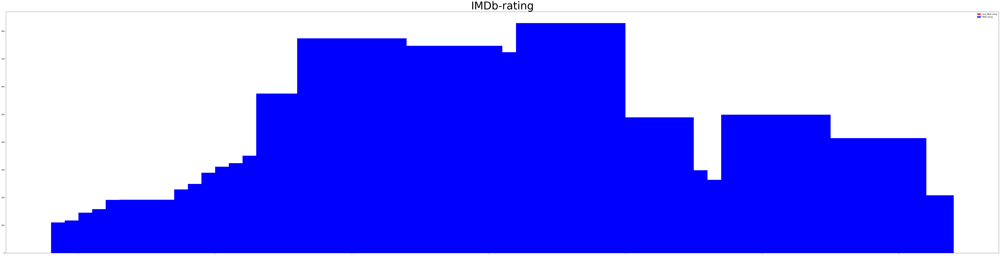

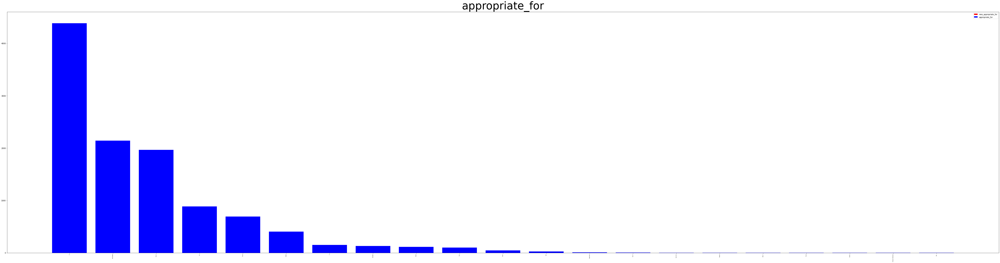

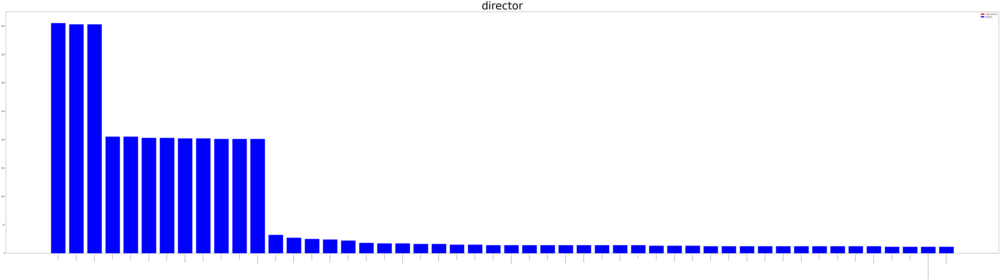

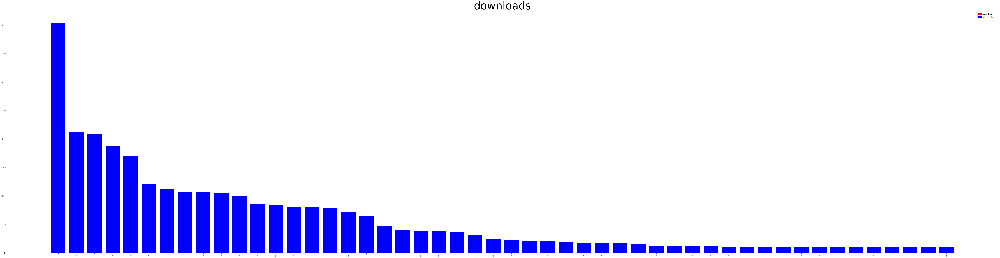

...

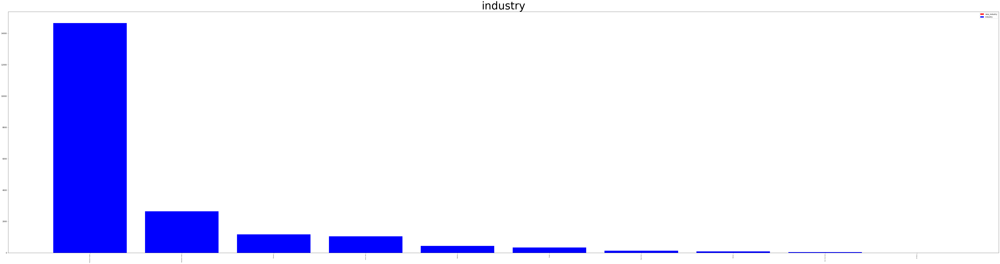

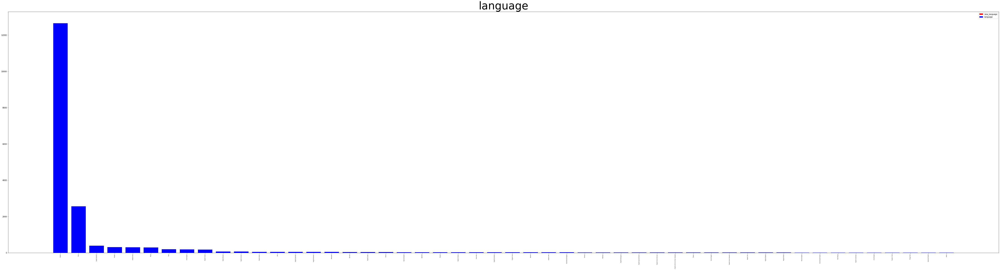

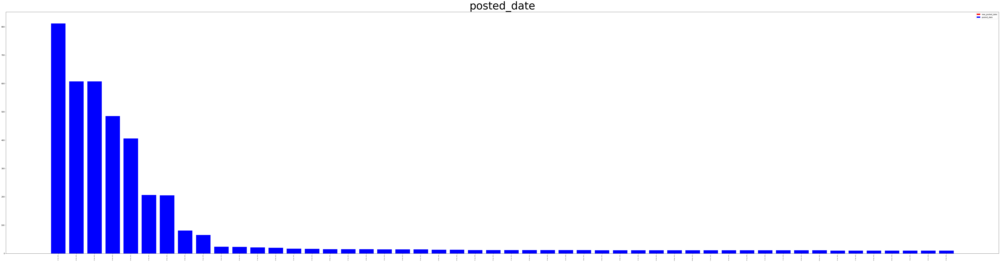

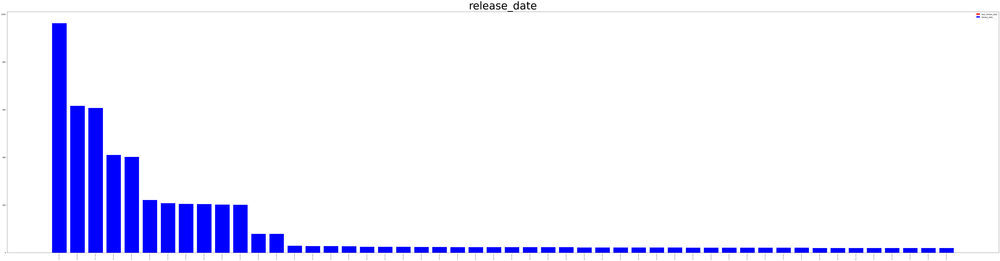

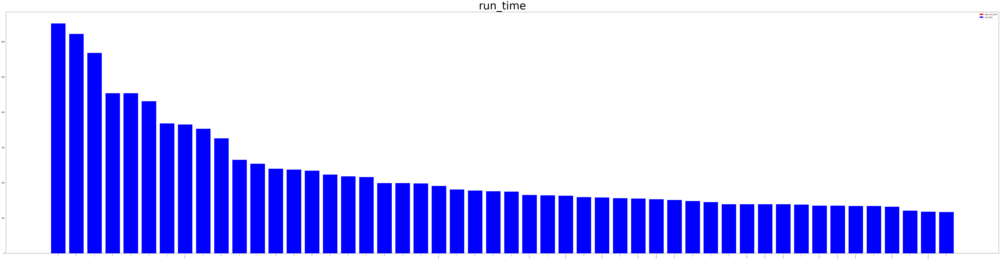

) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


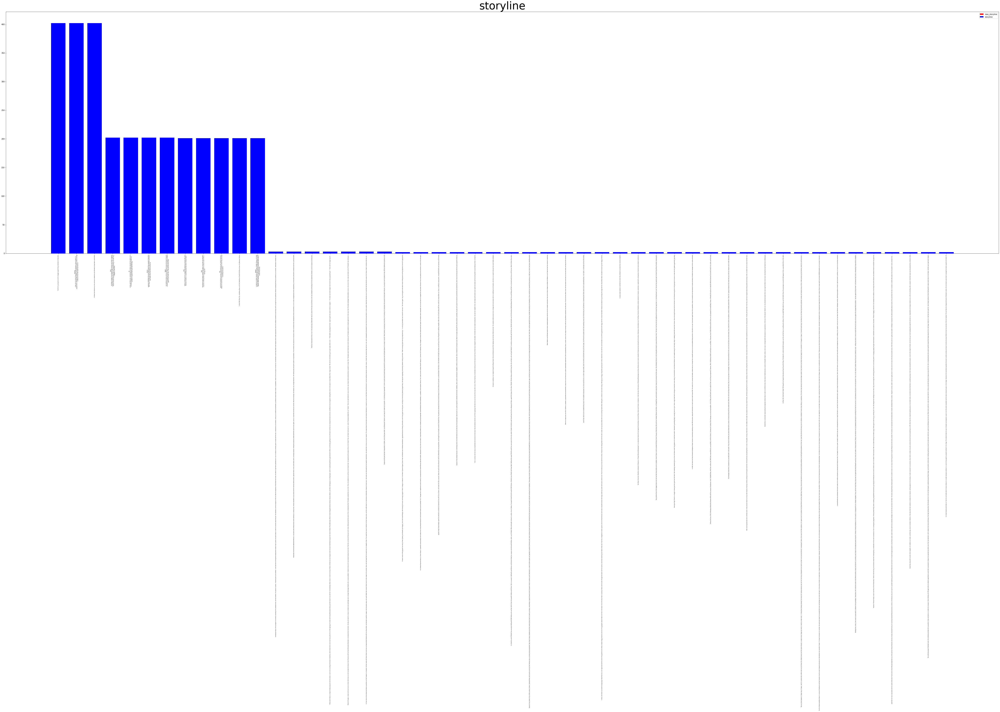

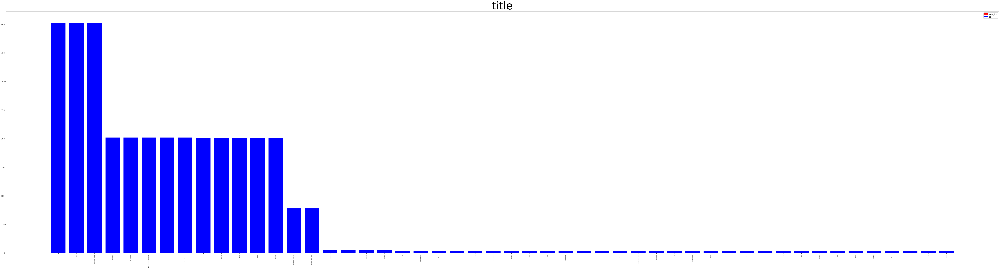

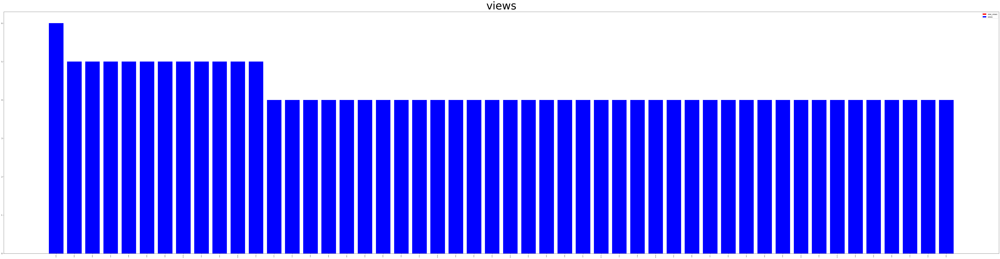

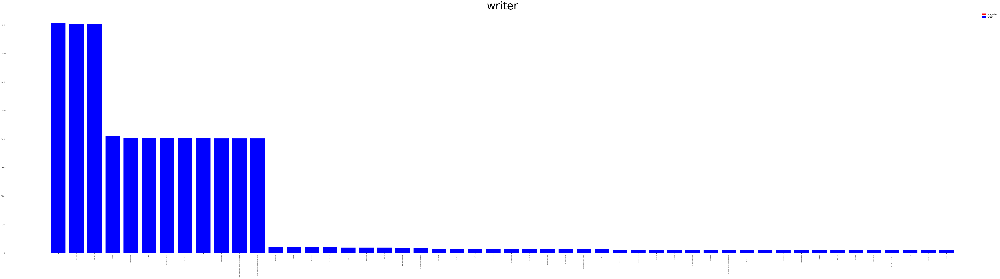

In [63]:
# 绘制频数柱状图对比
frequency_new = {key: df2_new[key].value_counts() for key in df2_new.columns}
for key in df2_new.columns:
    if not len(frequency_new[key].index):
        continue
    plt.figure(figsize=(100,25))
    plt.title(frequency_new[key].name, fontsize=60)
    plt.bar(frequency_new[key].index[:50], frequency_new[key].values[:50],color='r',label='new_' + frequency_new[key].name)  # 数量太多，截断显示
    plt.bar(frequency[key].index[:50], frequency[key].values[:50],color='b',label=frequency[key].name)  # 数量太多，截断显示
    plt.xticks(rotation=90, fontsize=5)
    plt.legend()
    plt.show()

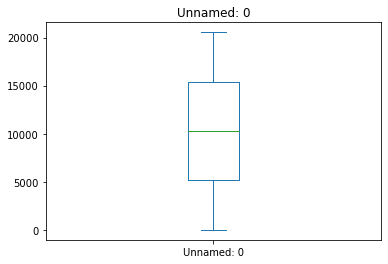

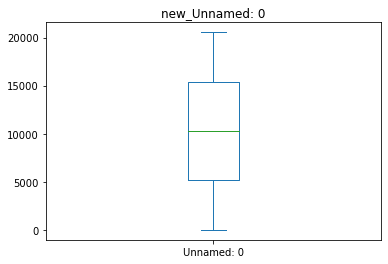

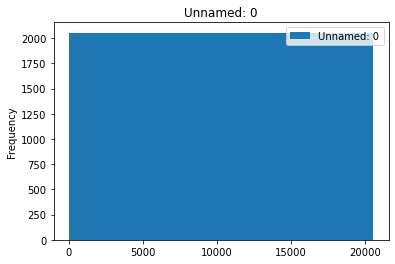

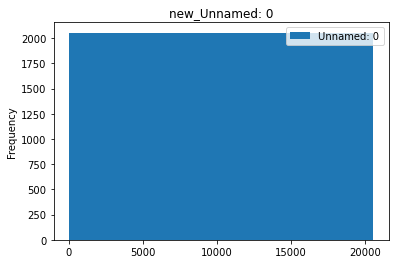

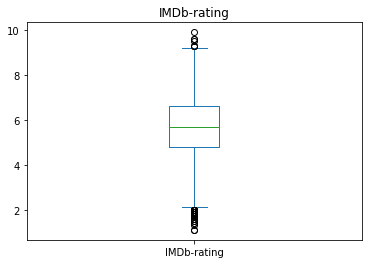

...

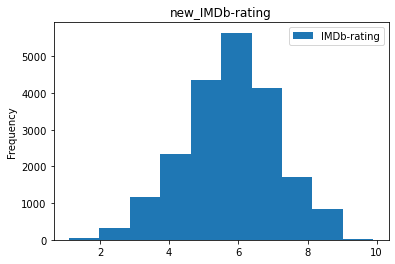

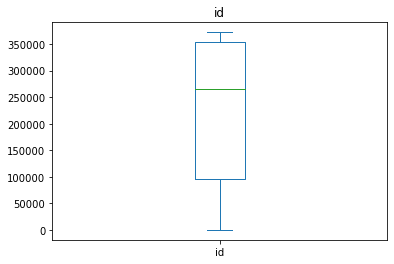

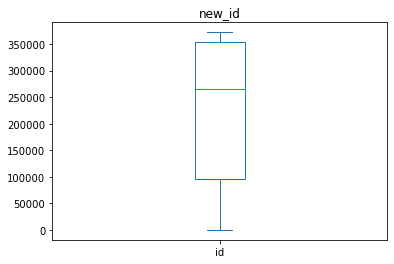

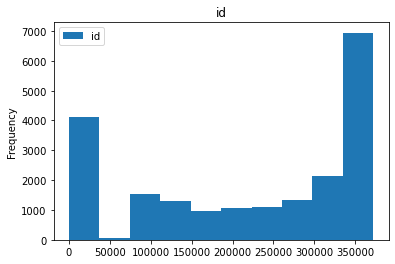

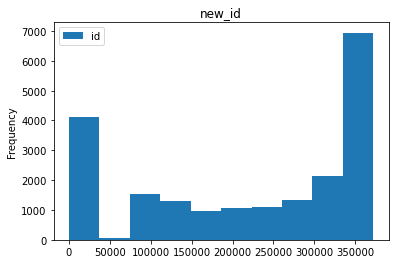

In [64]:
# 绘制数值属性直方图、盒图对比
numeric_keys = ['Unnamed: 0','IMDb-rating', 'id']  # 数值属性列
for key in numeric_keys:
    df2[[key]].plot(kind='box', title=key)
    df2_new[[key]].plot(kind='box', title='new_' + key)
    
    df2[[key]].plot(kind='hist', title=key)
    df2_new[[key]].plot(kind='hist', title='new_' + key)

分析：由于通过数据对象之间的相似性来填补缺失值，利用相似的数据填补缺失值，因此数据分布变化不大